# Imports

In [1]:
import numpy as np
import os
import sys
import pickle
import scipy
import pandas as pd

import matplotlib.pyplot as plt
import networkx as nx
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.cm import ScalarMappable

from pycirclize import Circos

## Helper Functions

In [2]:
%store -r analysis_hf
sys.path.insert(0, analysis_hf)

import fixedDensity as fd
import circularPlot as cp

# Set Directory Paths

In [3]:
# Directory path to load formatted Layer Data
%store -r layer_dataDir

# Directory path to save Calcualted Analysis Data
%store -r layer_CalData

# Directory path to save Figures
%store -r layer_Fig

# Loading

## Loading Covariance Matrices

In [4]:
# cov_SMI32_dict
with open(os.path.join(layer_CalData, 'cov_SMI32_dict.pkl'), 'rb') as f:
    cov_SMI32_dict = pickle.load(f)
f.close()

# cov_SMI32_dict_w
with open(os.path.join(layer_CalData, 'cov_SMI32_dict_w.pkl'), 'rb') as f:
    cov_SMI32_dict_w = pickle.load(f)
f.close()

## Loading Layer Neuron Labels (SMI32)

In [5]:
# SMI32_Labels
with open(os.path.join(layer_dataDir, 'SMI32_Labels.pkl'), 'rb') as f:
    SMI32_Labels = pickle.load(f)
f.close()

# Draw Graph Networks (NeuN)

## Define Variables

### Label Order

In [6]:
order = ['ln_L23_1', 'ln_L56_1', 'ln_L23_2', 'ln_L56_2', 'ln_L23_3', 
         'ln_L56_3', 'ln_L23_4', 'ln_L56_4', 'ln_L23_5', 'ln_L56_5']

### Color Dictionary

In [7]:
color_dict = {'ln_L23_1' : 'red', 'ln_L56_1' : '#FFB6C1', 
              'ln_L23_2' : 'orange', 'ln_L56_2' : '#FFD700',
              'ln_L23_3' : 'green', 'ln_L56_3' : '#98FB98',
              'ln_L23_4' : 'blue', 'ln_L56_4' : '#ADD8E6',
              'ln_L23_5' : 'purple', 'ln_L56_5' : '#E6E6FA'}
              
#     'L23_1': {'original': 'red', 'pastel': '#FFB6C1'},    # Red and Pastel Red
#     'L56_1': {'original': 'blue', 'pastel': '#ADD8E6'},   # Blue and Pastel Blue
#     'L23_2': {'original': 'green', 'pastel': '#98FB98'},  # Green and Pastel Green
#     'L56_2': {'original': 'purple', 'pastel': '#E6E6FA'}, # Purple and Pastel Purple
#     'L23_3': {'original': 'orange', 'pastel': '#FFD700'}, # Orange and Pastel Orange
#     'L56_3': {'original': 'yellow', 'pastel': '#FFFFE0'}, # Yellow and Pastel Yellow
#     'L23_4': {'original': 'brown', 'pastel': '#D2B48C'},  # Brown and Pastel Brown
#     'L56_4': {'original': 'pink', 'pastel': '#FFC0CB'},   # Pink and Pastel Pink
#     'L23_5': {'original': 'cyan', 'pastel': '#00FFFF'},   # Cyan and Pastel Cyan
#     'L56_5': {'original': 'gray', 'pastel': '#D3D3D3'}   # Gray and Pastel Gray
# }

### Set fixed density value 

In [8]:
fd_val = 10

### Long Track

In [9]:
long_track = [('ln_L23_4', 'ln_L56_2'), ('ln_L23_5', 'ln_L56_2')]

### Short Track

In [10]:
short_track = [('ln_L23_2', 'ln_L56_1'), ('ln_L23_3', 'ln_L56_2'), ('ln_L23_4', 'ln_L56_2'), ('ln_L23_5', 'ln_L56_2'), 
               ('ln_L23_4', 'ln_L56_3'), ('ln_L23_5', 'ln_L56_4')]

## Region 1, 2, 3

In [11]:
reg_123 = [('ln_L23_1', 'ln_L23_2'), ('ln_L23_1', 'ln_L23_3'), ('ln_L23_1', 'ln_L56_1'), ('ln_L23_1', 'ln_L56_2'), ('ln_L23_1', 'ln_L56_3'), 
           ('ln_L23_2', 'ln_L23_3'), ('ln_L23_2', 'ln_L56_1'), ('ln_L23_2', 'ln_L56_2'), ('ln_L23_2', 'ln_L56_3'), 
           ('ln_L23_3', 'ln_L56_1'), ('ln_L23_3', 'ln_L56_2'), ('ln_L23_3', 'ln_L56_3'),
           ('ln_L56_1', 'ln_L56_2'), ('ln_L56_1', 'ln_L56_3'), 
           ('ln_L56_2', 'ln_L56_3')]

## Region 2, 4, 5

In [12]:
reg_245 = [('ln_L23_2', 'ln_L23_4'), ('ln_L23_2', 'ln_L23_5'), ('ln_L23_2', 'ln_L56_2'), ('ln_L23_2', 'ln_L56_4'), ('ln_L23_2', 'ln_L56_5'), 
           ('ln_L23_4', 'ln_L23_5'), ('ln_L23_4', 'ln_L56_2'), ('ln_L23_4', 'ln_L56_4'), ('ln_L23_4', 'ln_L56_5'), 
           ('ln_L23_5', 'ln_L56_2'), ('ln_L23_5', 'ln_L56_4'), ('ln_L23_5', 'ln_L56_5'),
           ('ln_L56_2', 'ln_L56_4'), ('ln_L56_2', 'ln_L56_5'), 
           ('ln_L56_4', 'ln_L56_5')]

### Define Variables

In [13]:
# Variable setting
neuron_type = "SMI32"

cov_dict = cov_SMI32_dict

data_label = SMI32_Labels

### Generate Dict for Node Name Assignment

In [14]:
labels_dict = {}

node_num = 0

for label in data_label:
    labels_dict[node_num] = label
    node_num += 1

print(labels_dict)

{0: 'ln_L23_1', 1: 'ln_L23_2', 2: 'ln_L23_3', 3: 'ln_L23_4', 4: 'ln_L23_5', 5: 'ln_L56_1', 6: 'ln_L56_2', 7: 'ln_L56_3', 8: 'ln_L56_4', 9: 'ln_L56_5'}


## HC

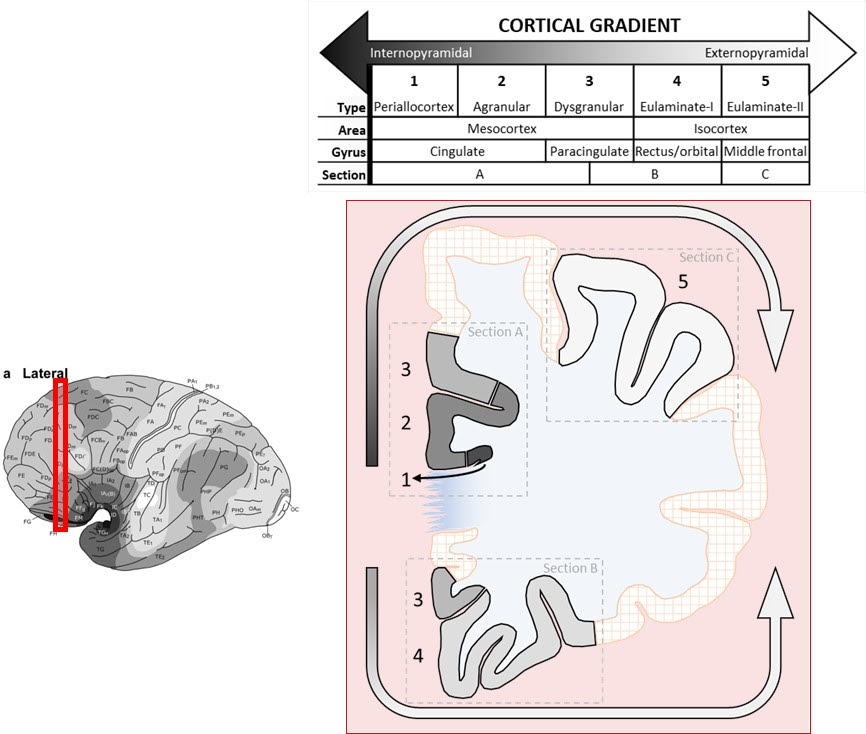

Focus on 1, 4, 5 cortical types --> FeedForward Loop

vs FeedBackward Loop

vs Unclear pathways

/Users/hyung/opt/anaconda3/envs/Network_Analysis/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/hyung/opt/anaconda3/envs/Network_Analysis/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/Users/hyung/opt/anaconda3/envs/Network_Analysis/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/hyung/opt/anaconda3/envs/Network_Analysis/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/hyung/opt/anaconda3/envs/Network_Analysis/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret =

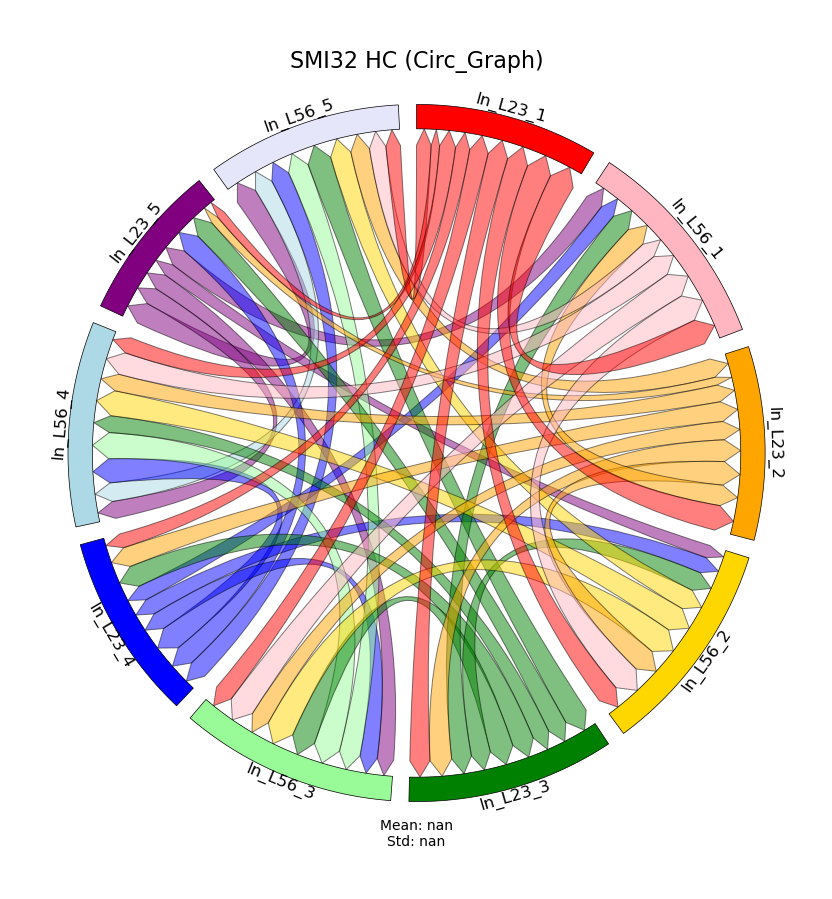

In [15]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

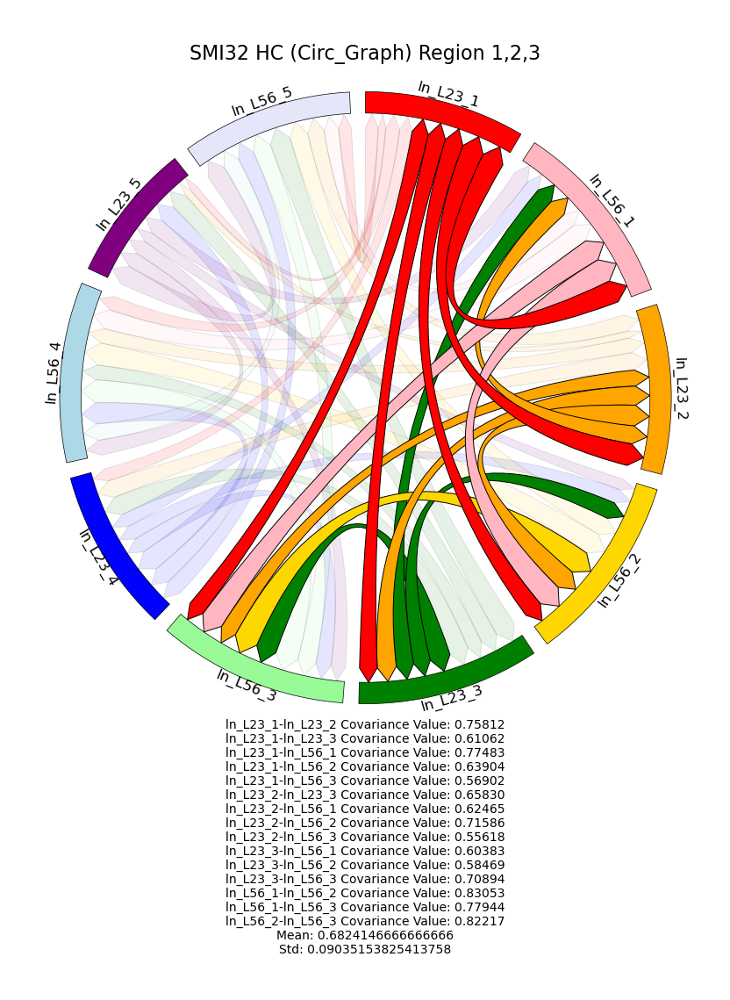

In [16]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track, 
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

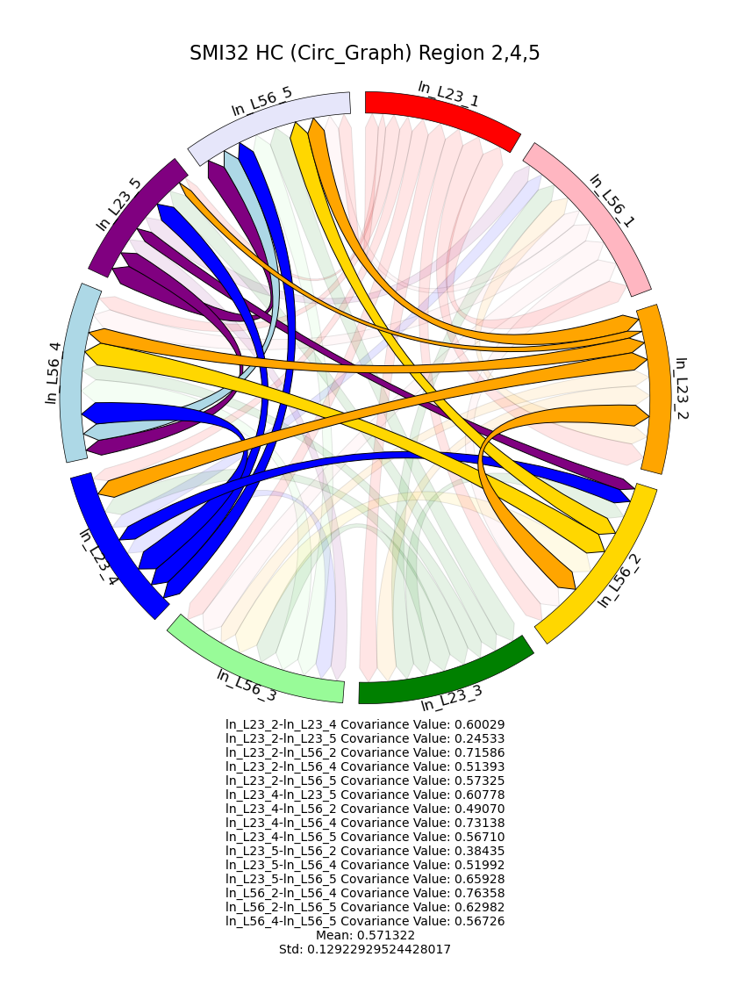

In [17]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track, 
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

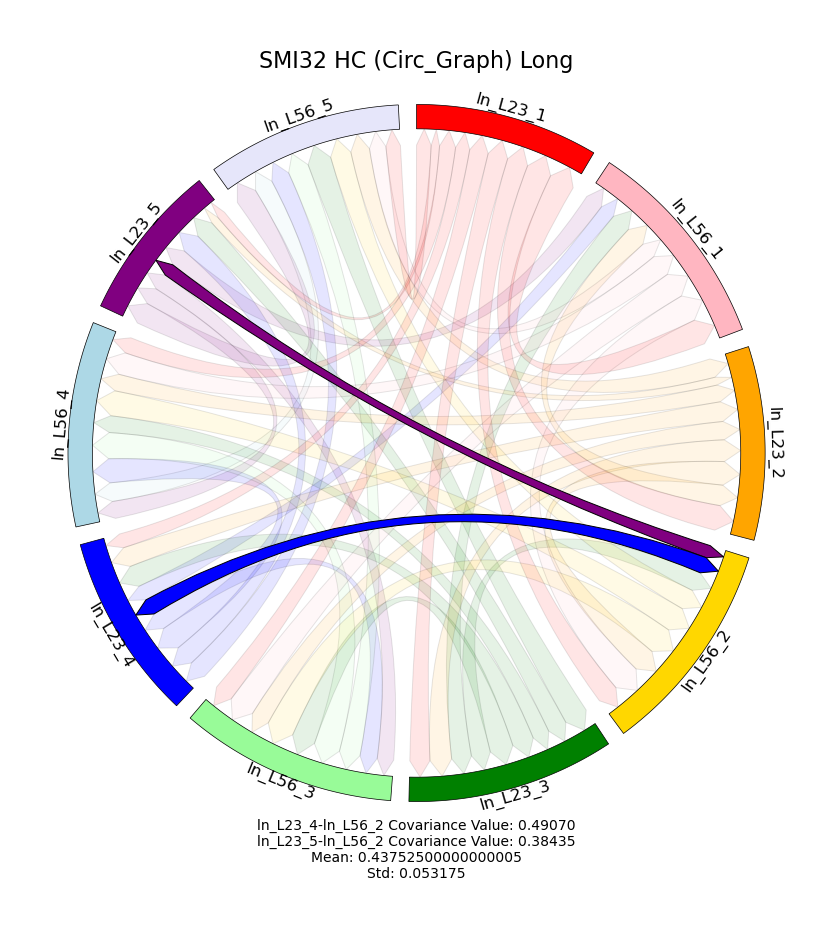

In [18]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long = True)

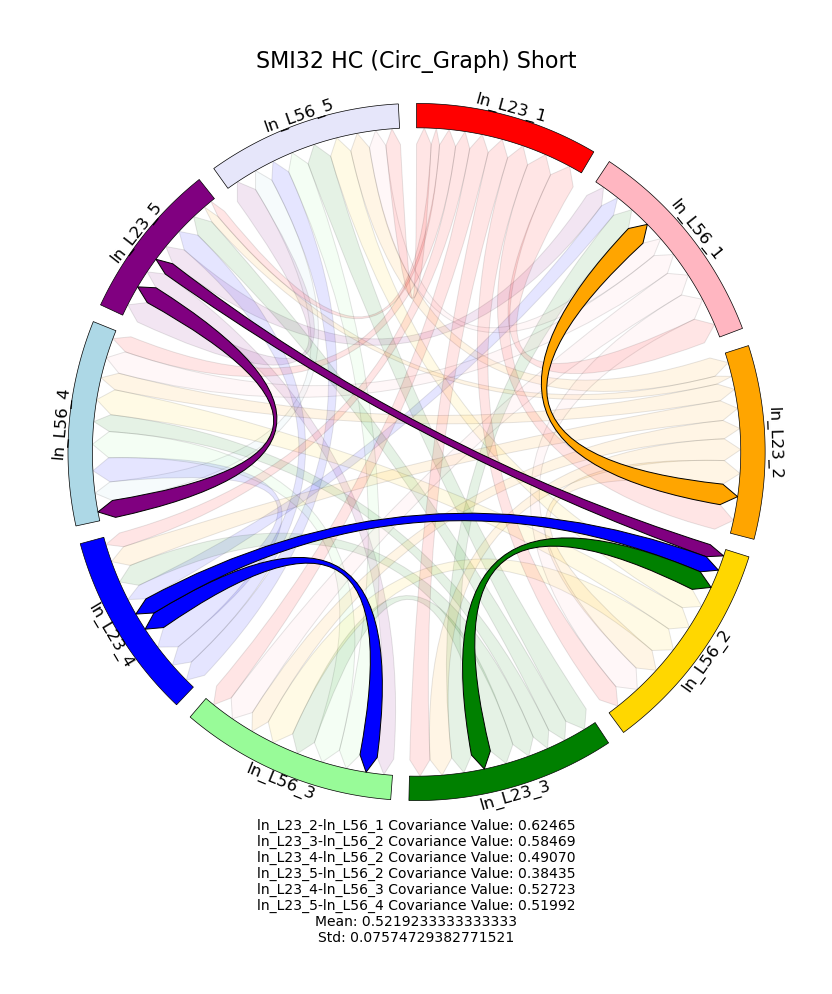

In [19]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short = True)

## Tau

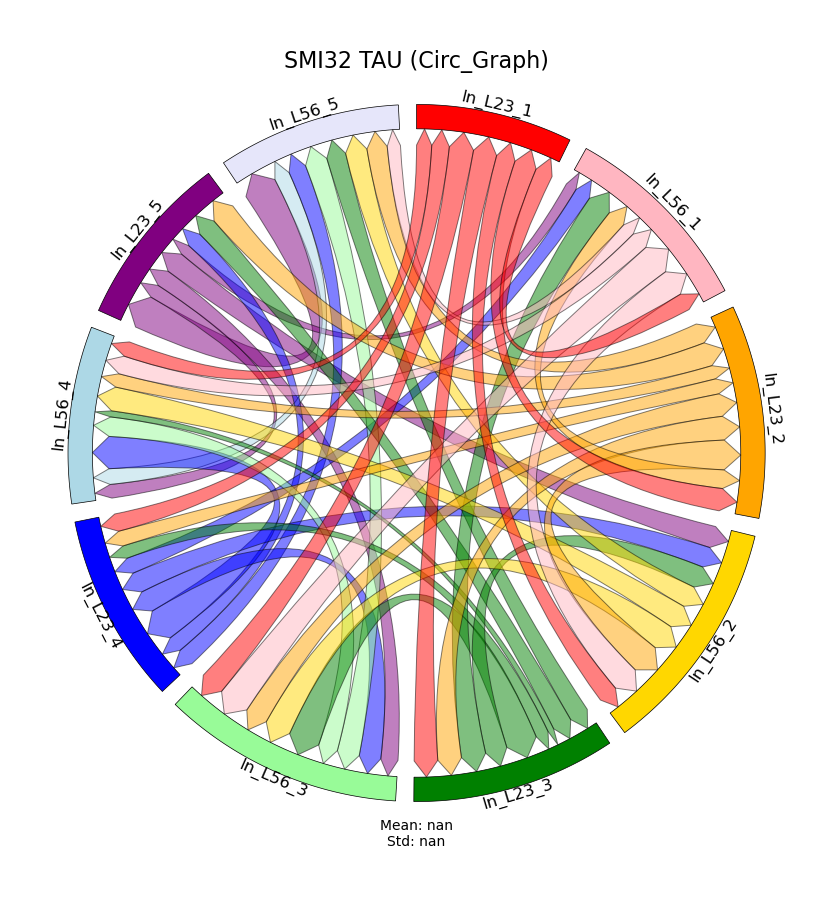

In [20]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

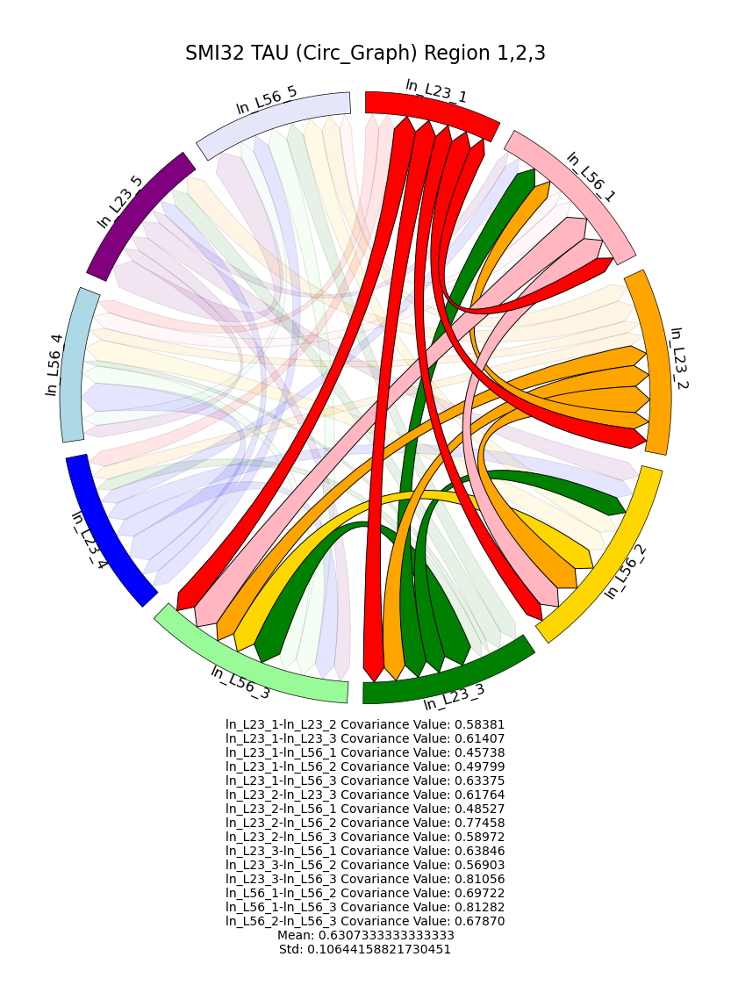

In [21]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track, 
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

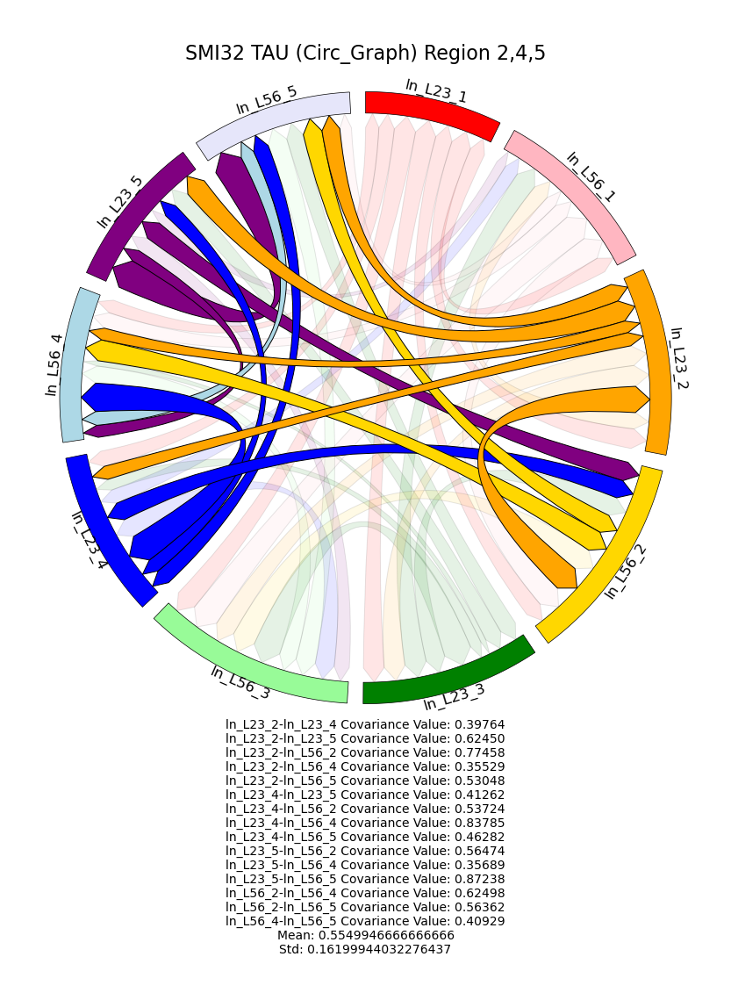

In [22]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track, 
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

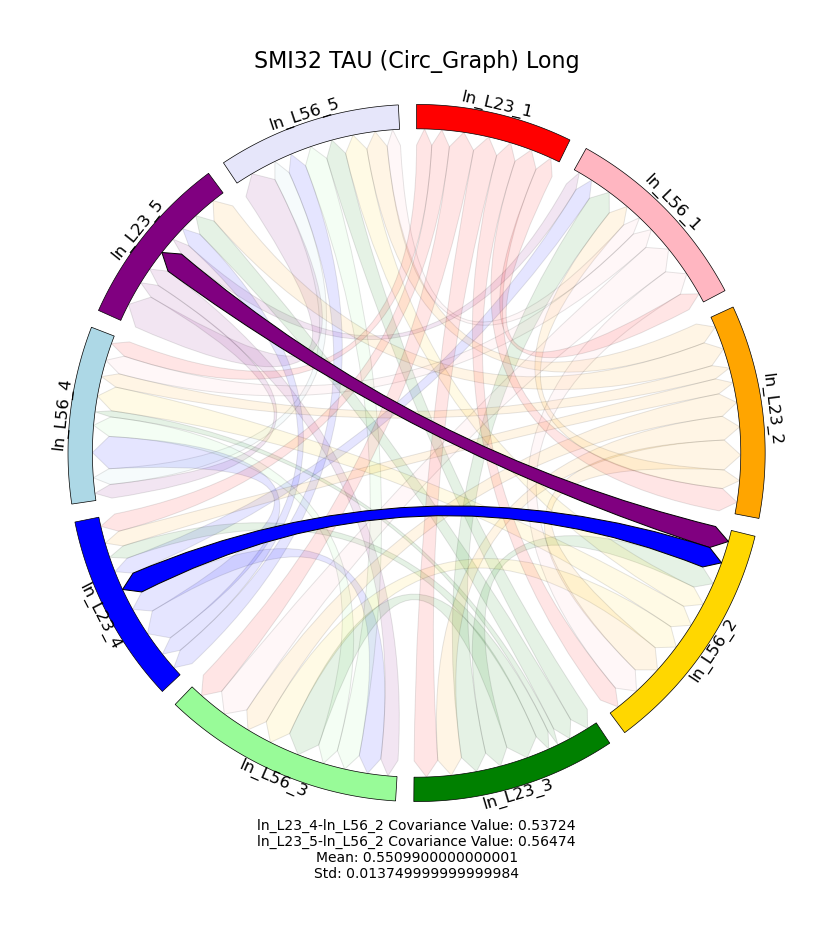

In [23]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long=True)

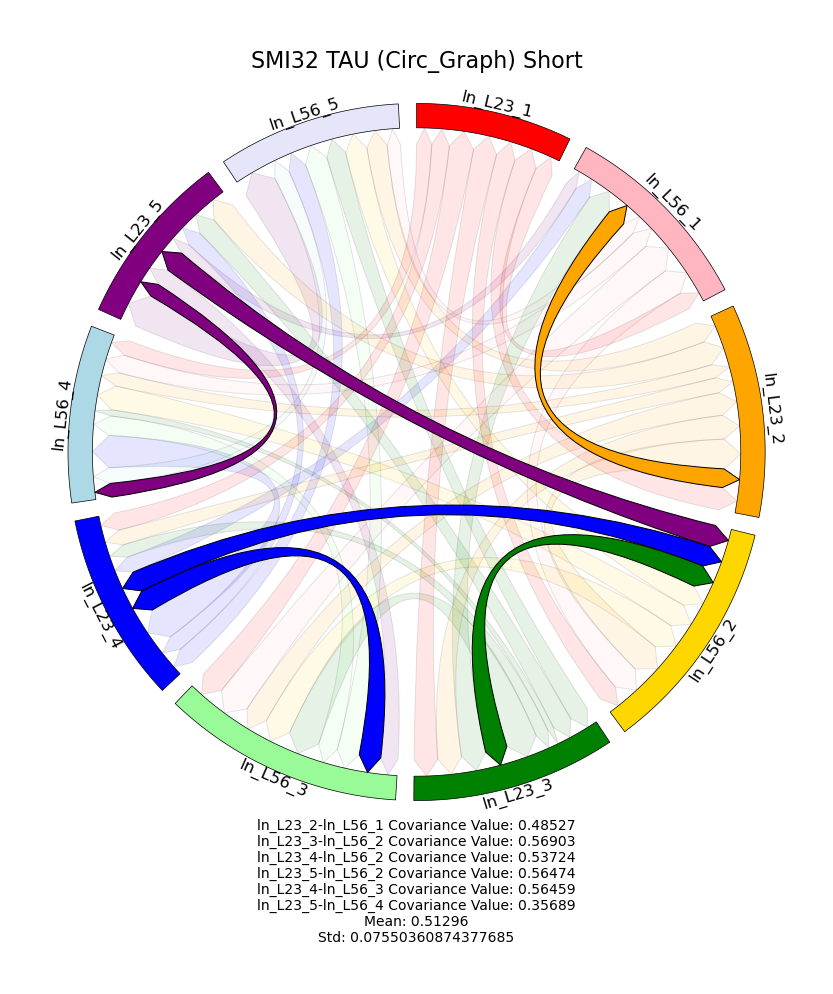

In [24]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short=True)

## TDP

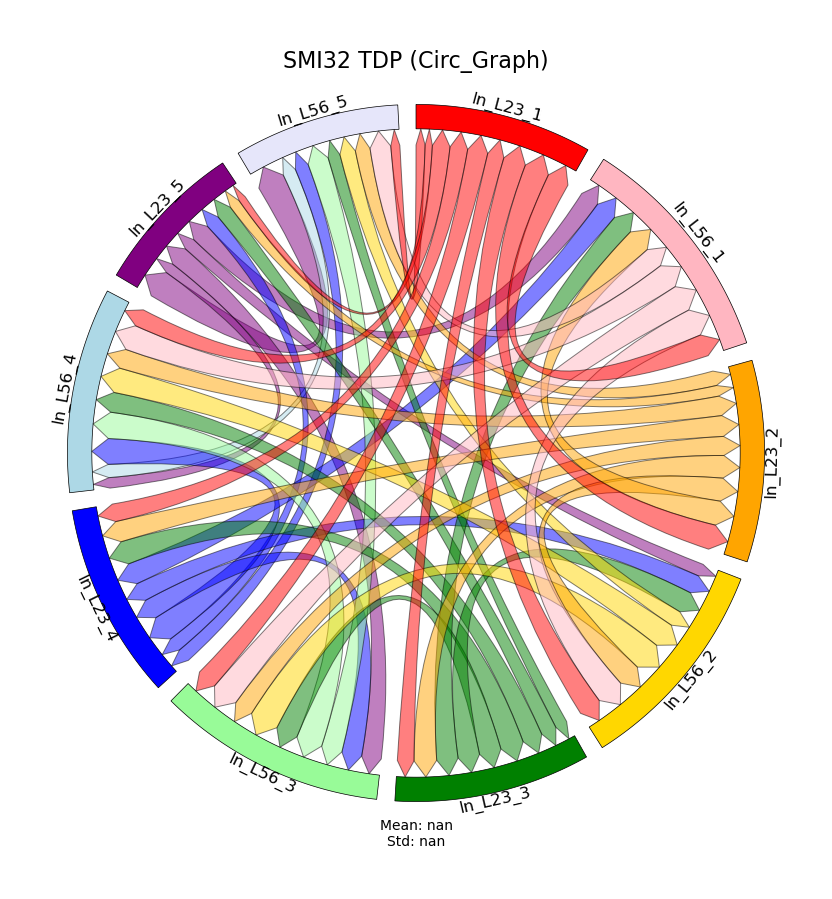

In [25]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

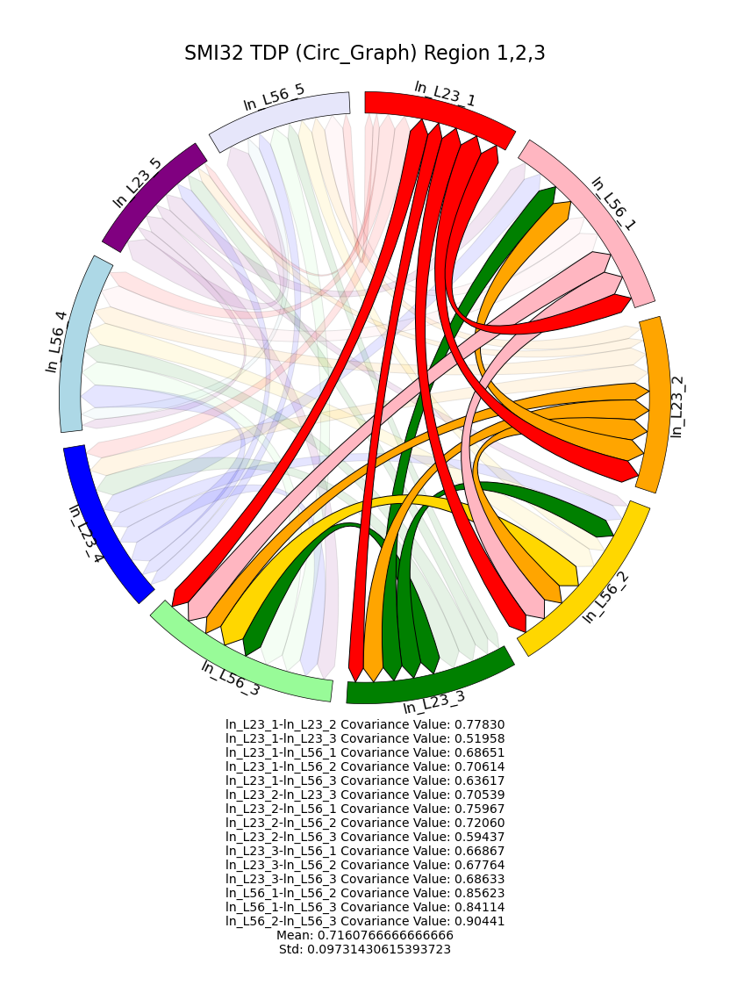

In [26]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track,
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

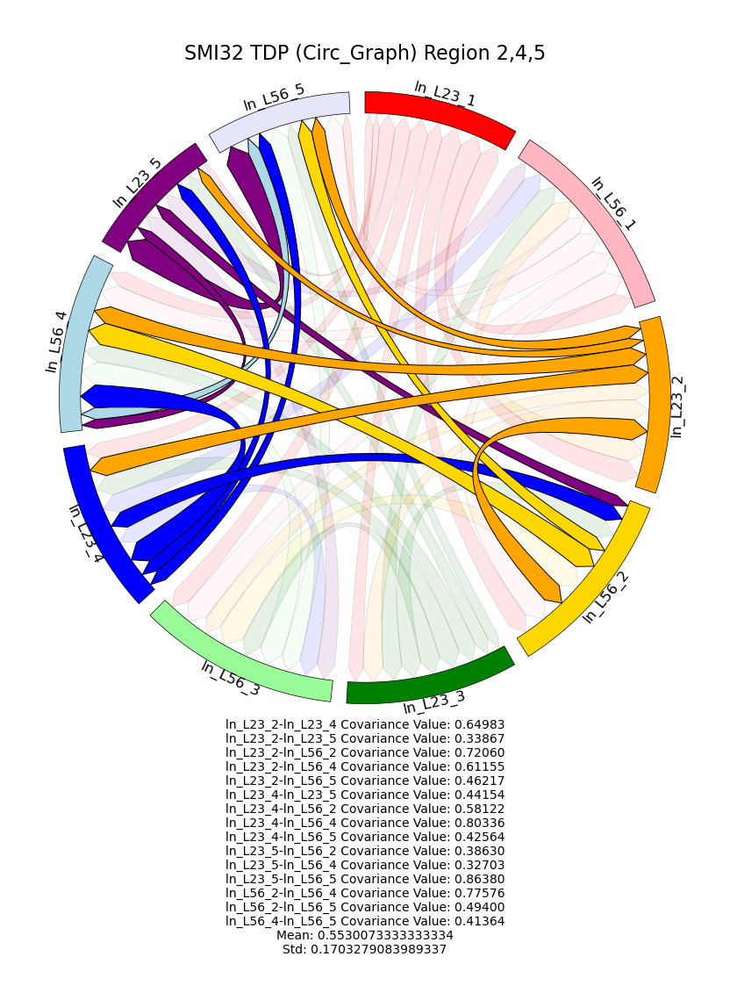

In [27]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track,
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

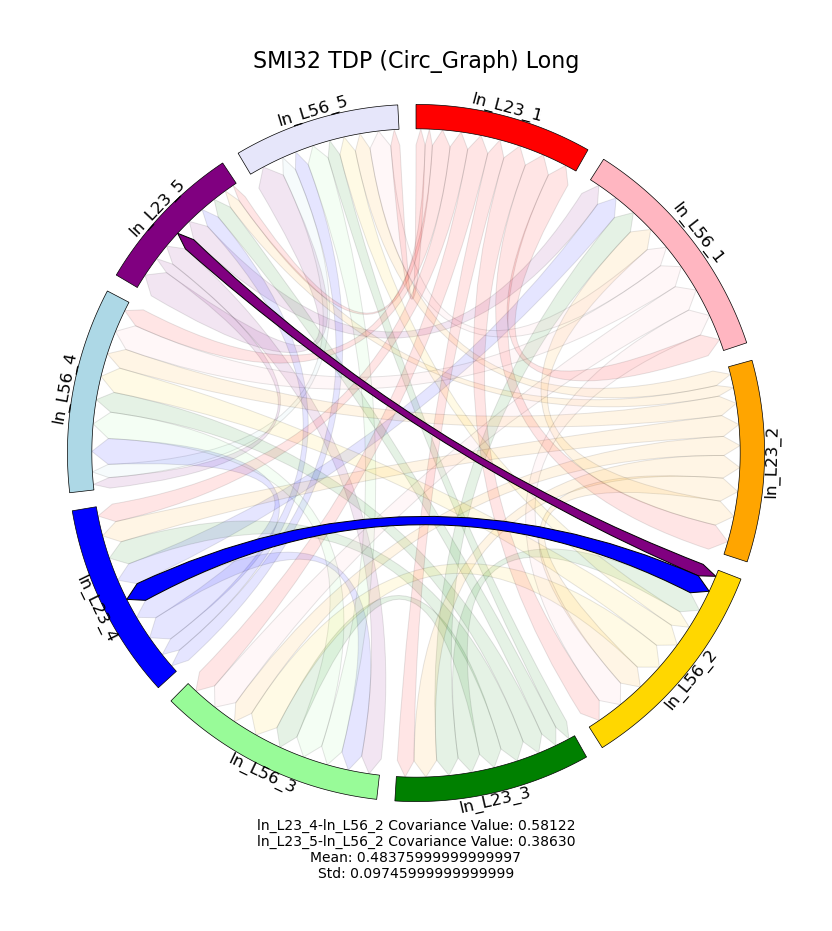

In [28]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long=True)

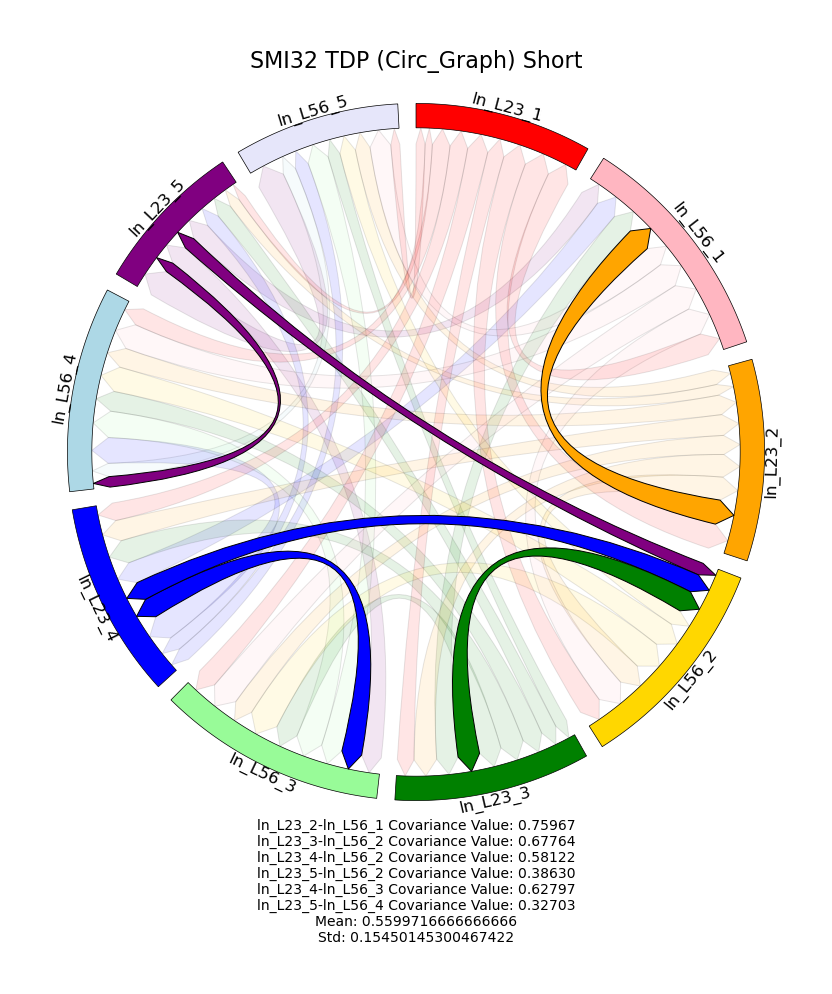

In [29]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short=True)

## HC > Tau

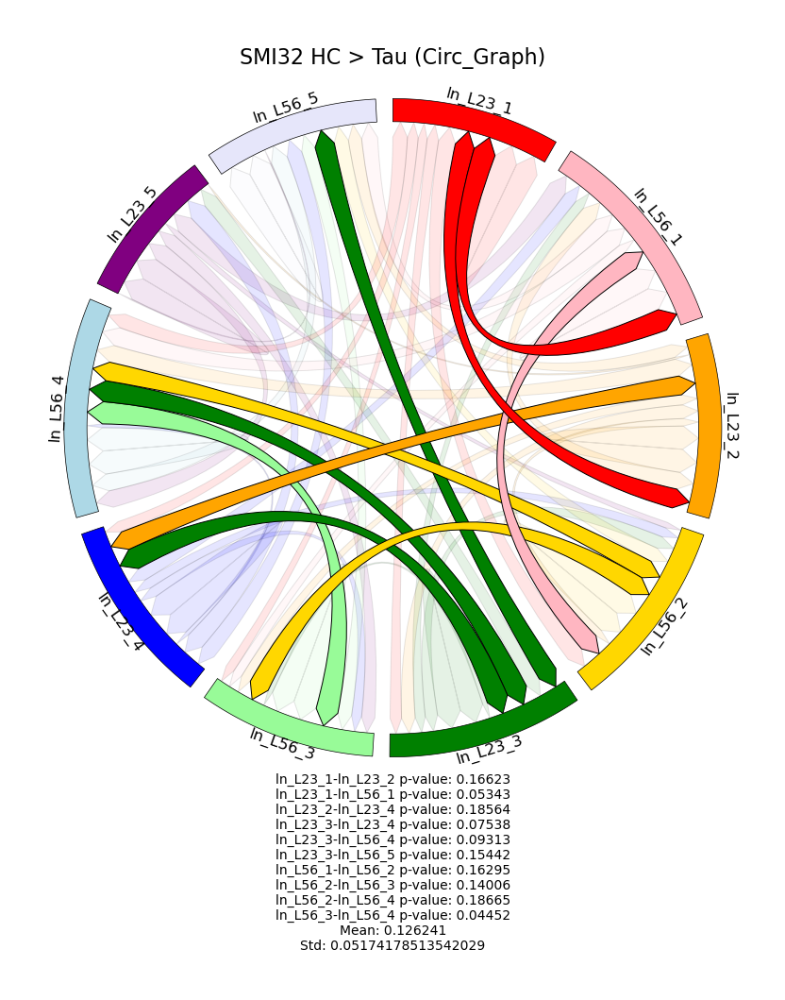

In [30]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

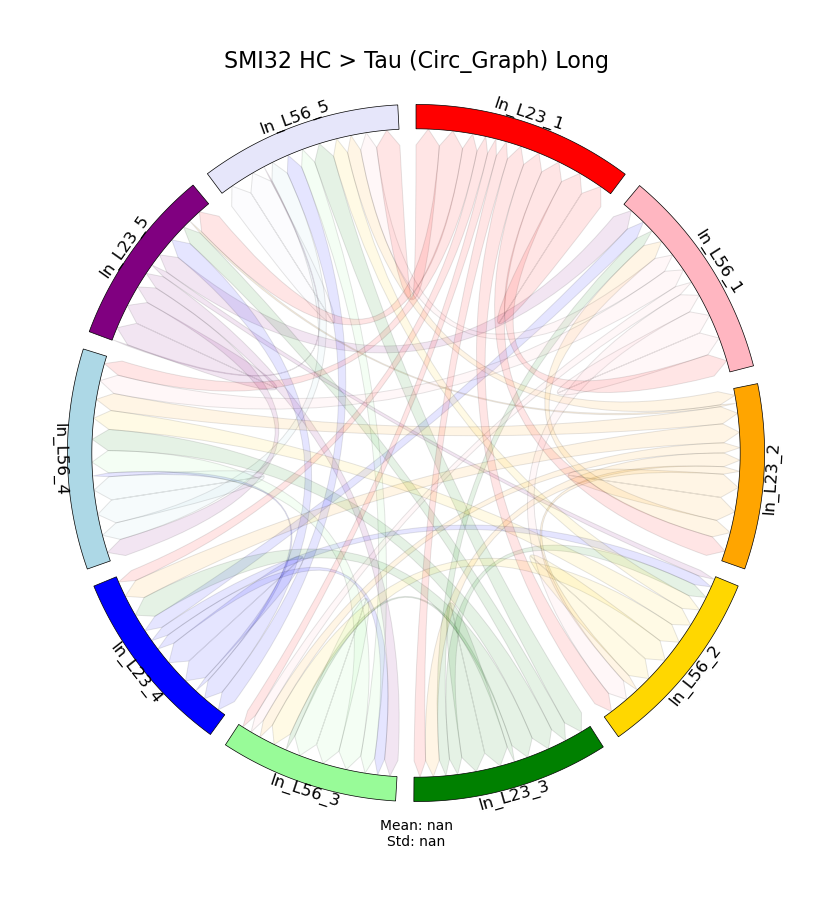

In [31]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

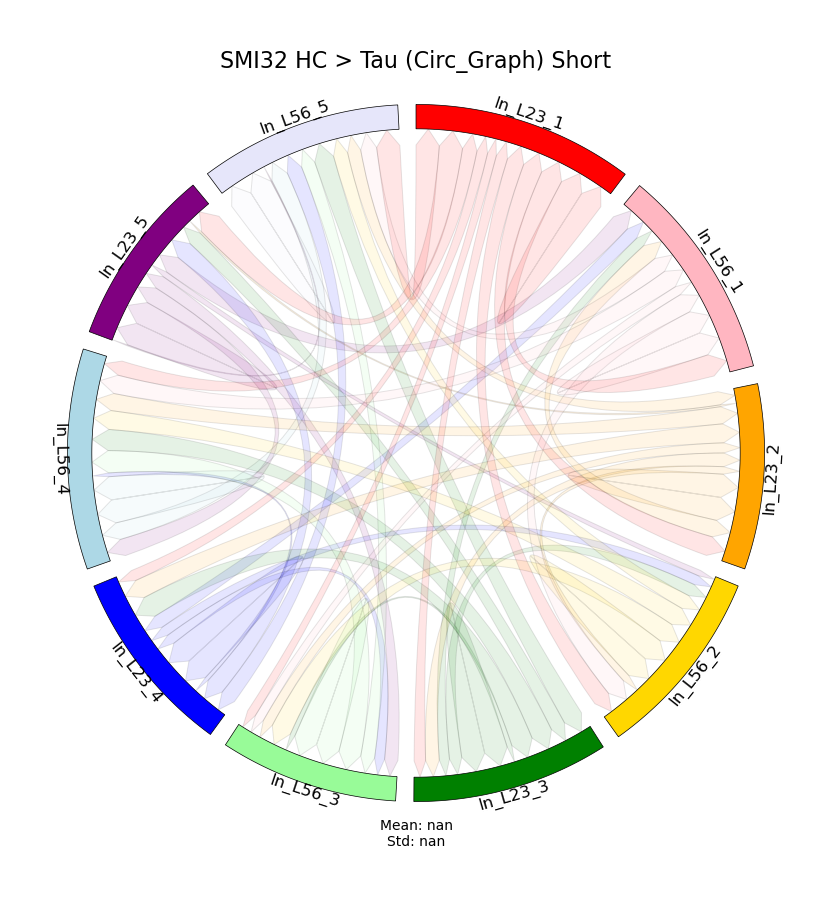

In [32]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## Tau > HC

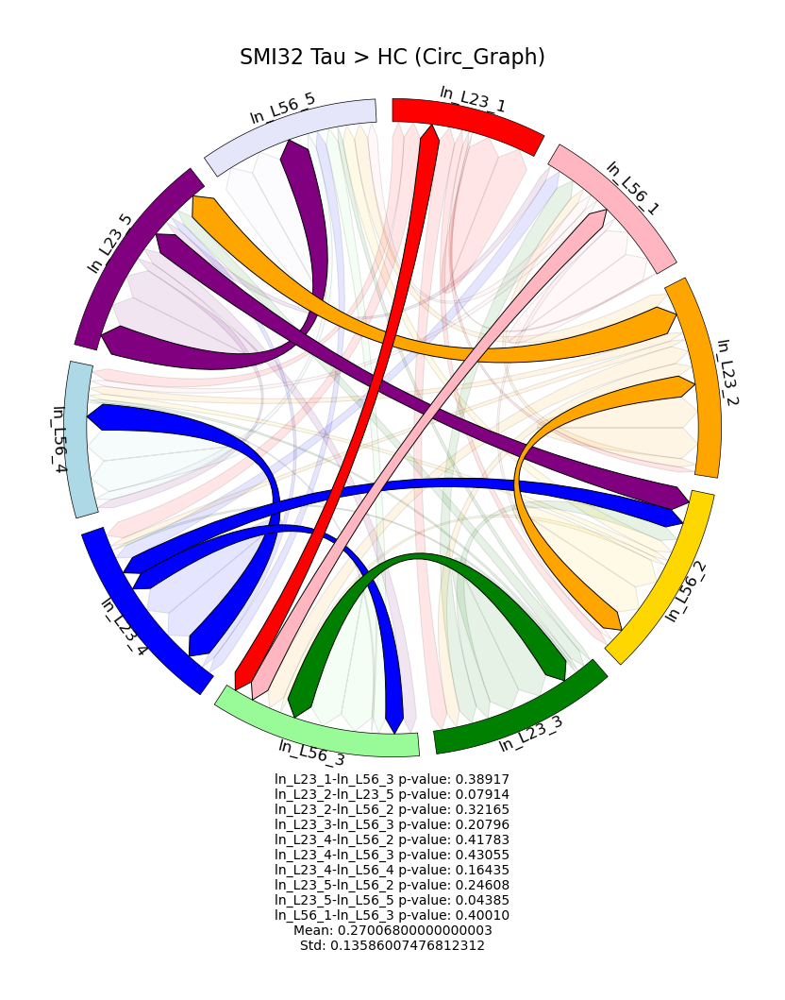

In [33]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

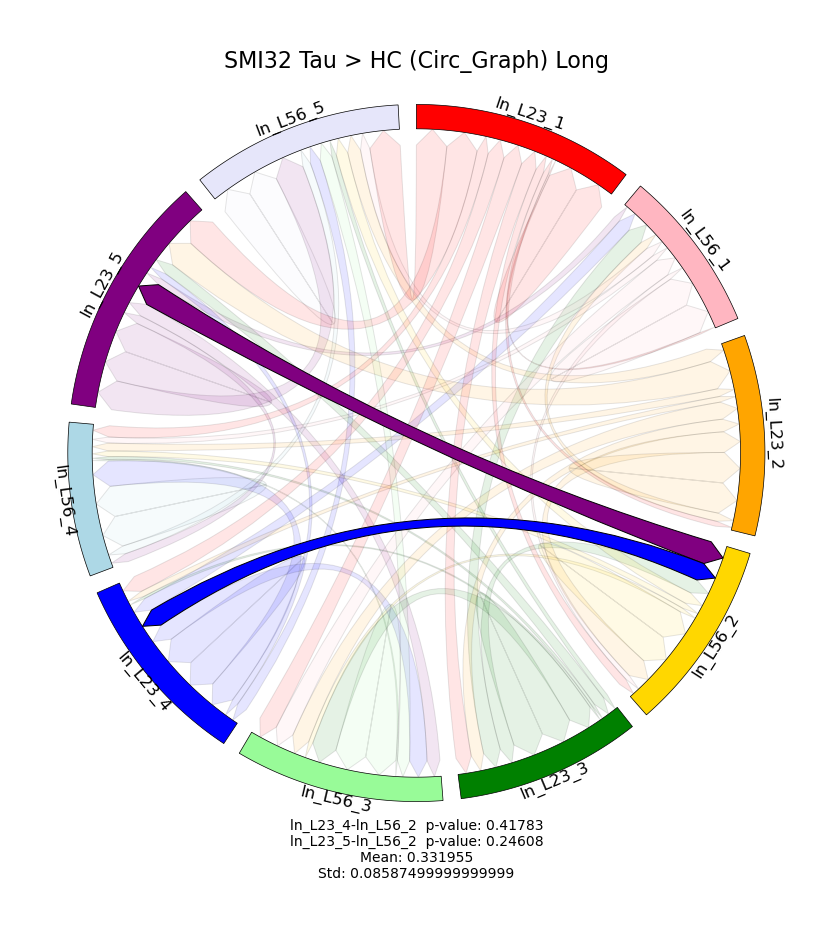

In [34]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

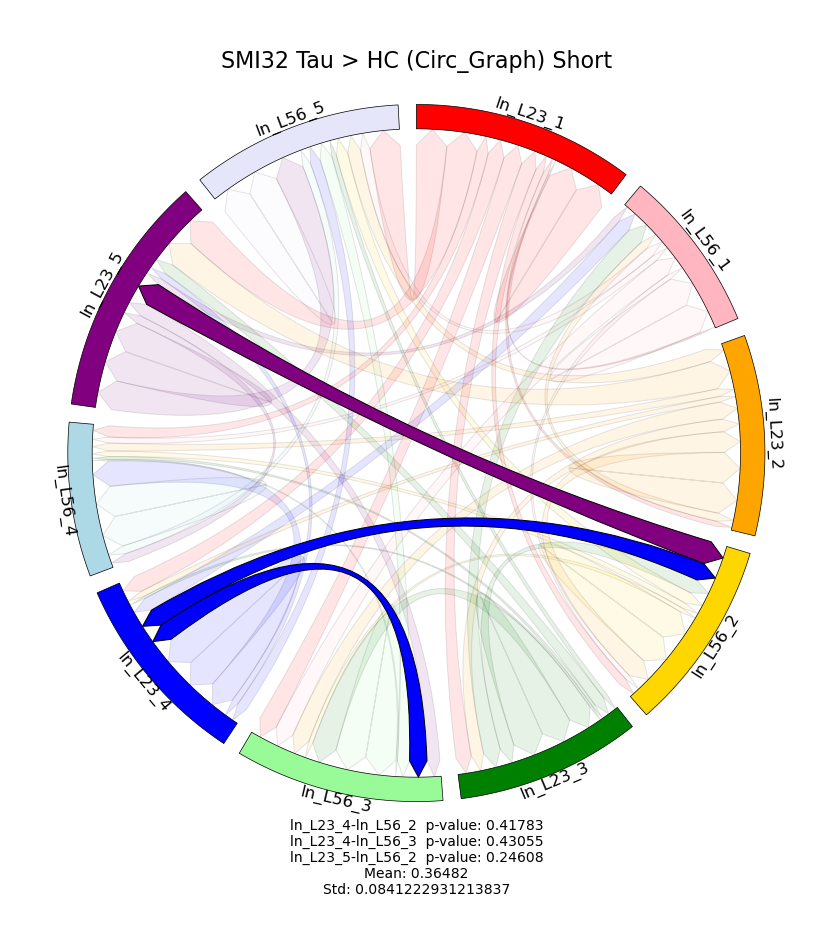

In [35]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## HC > TDP

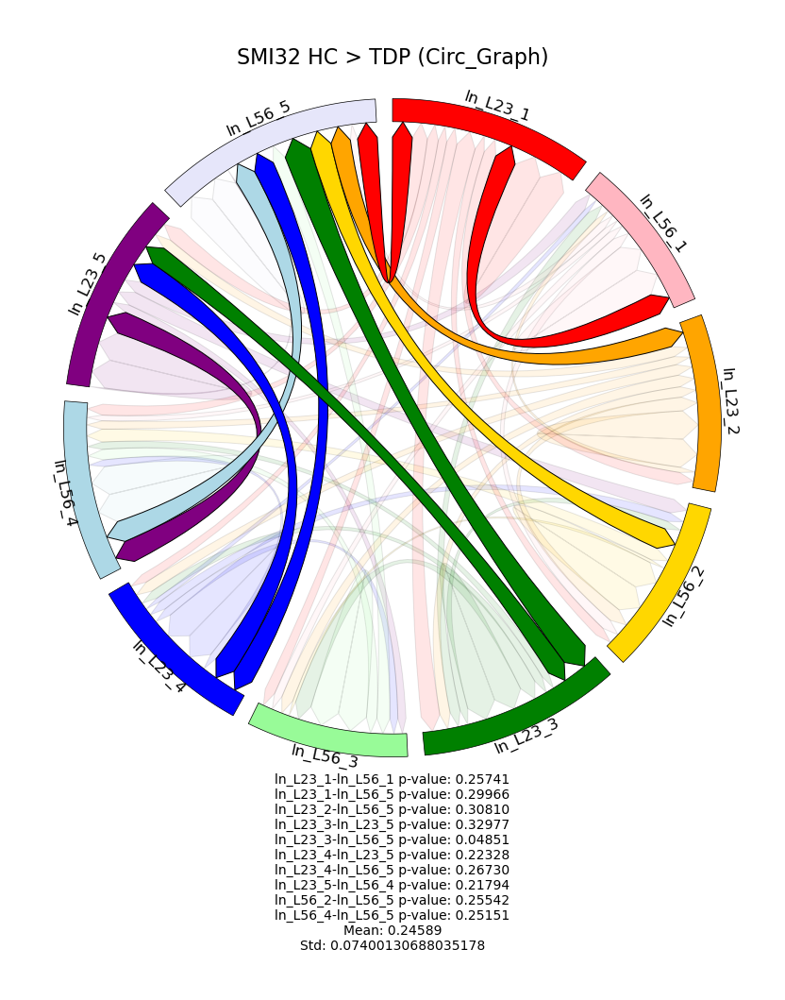

In [36]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

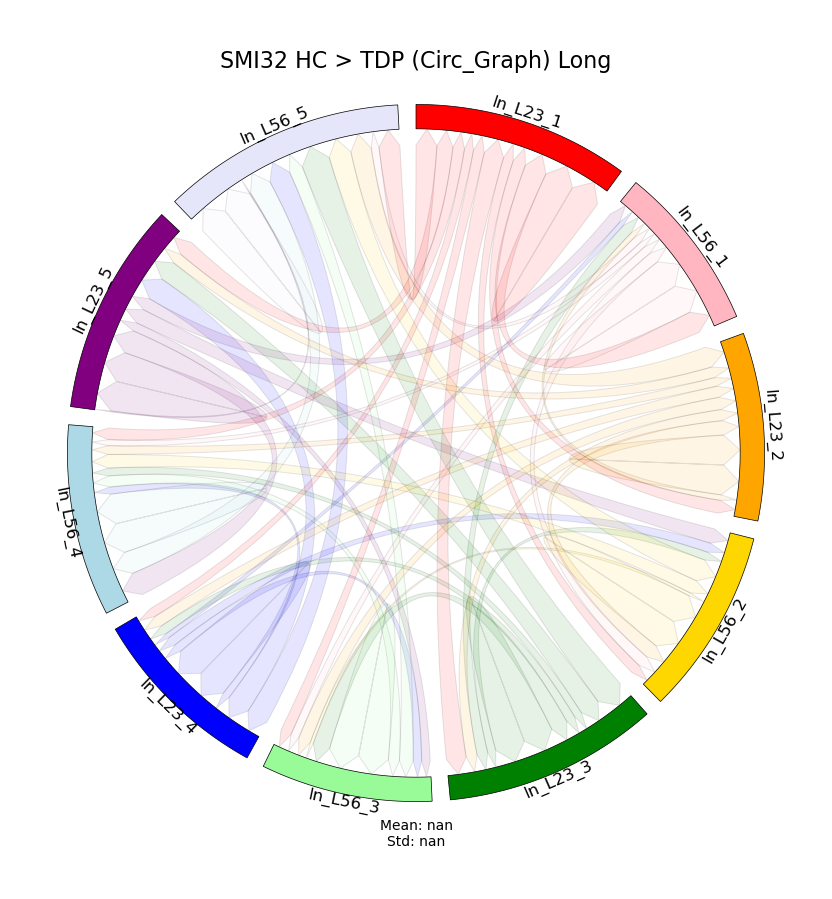

In [37]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

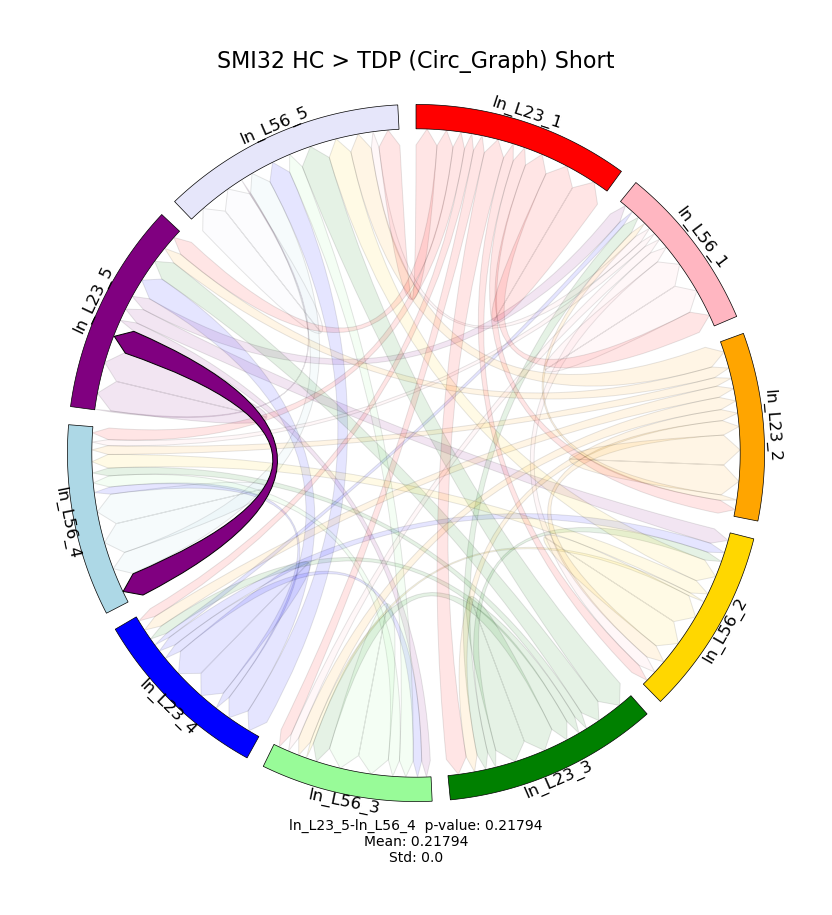

In [38]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## TDP > HC

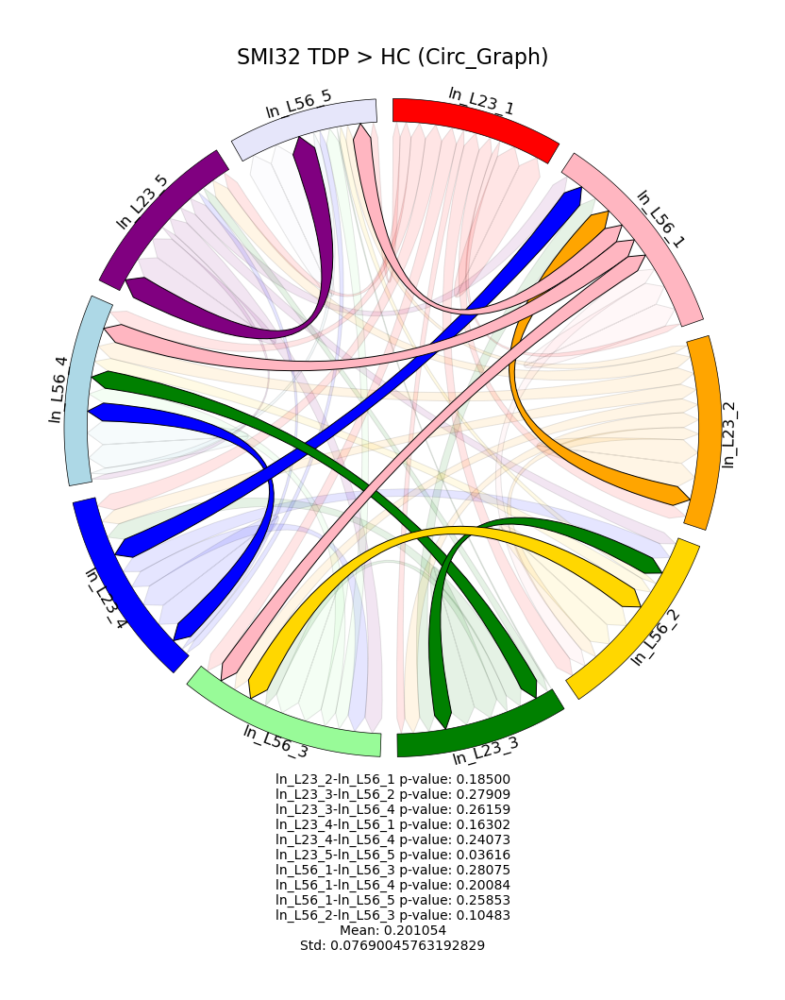

In [39]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

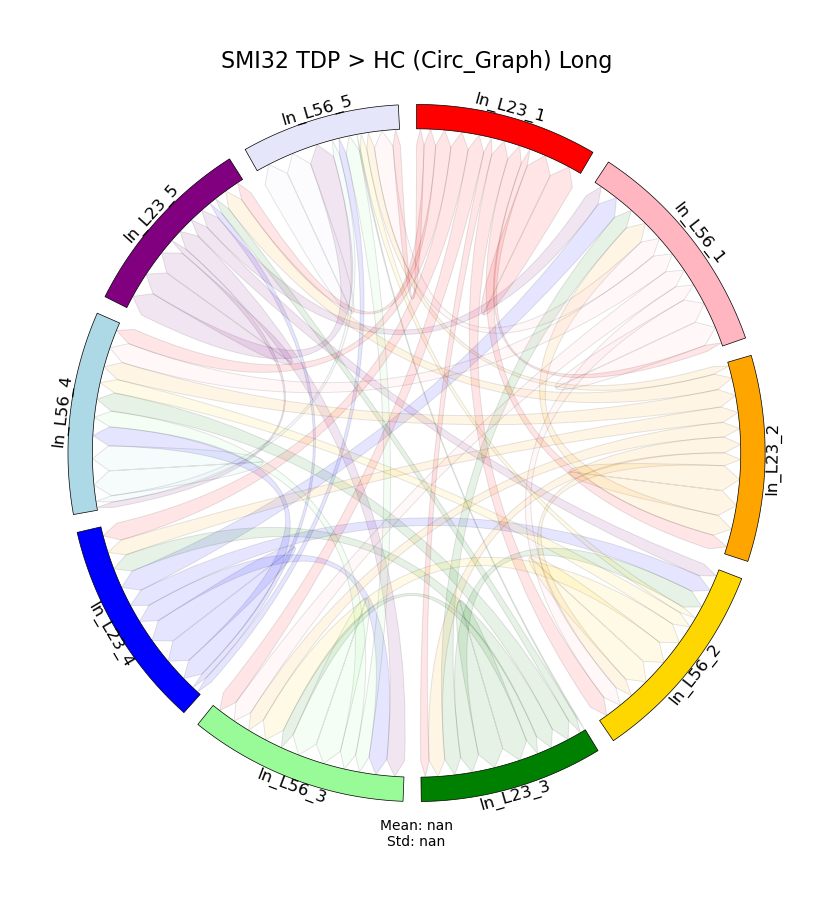

In [40]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

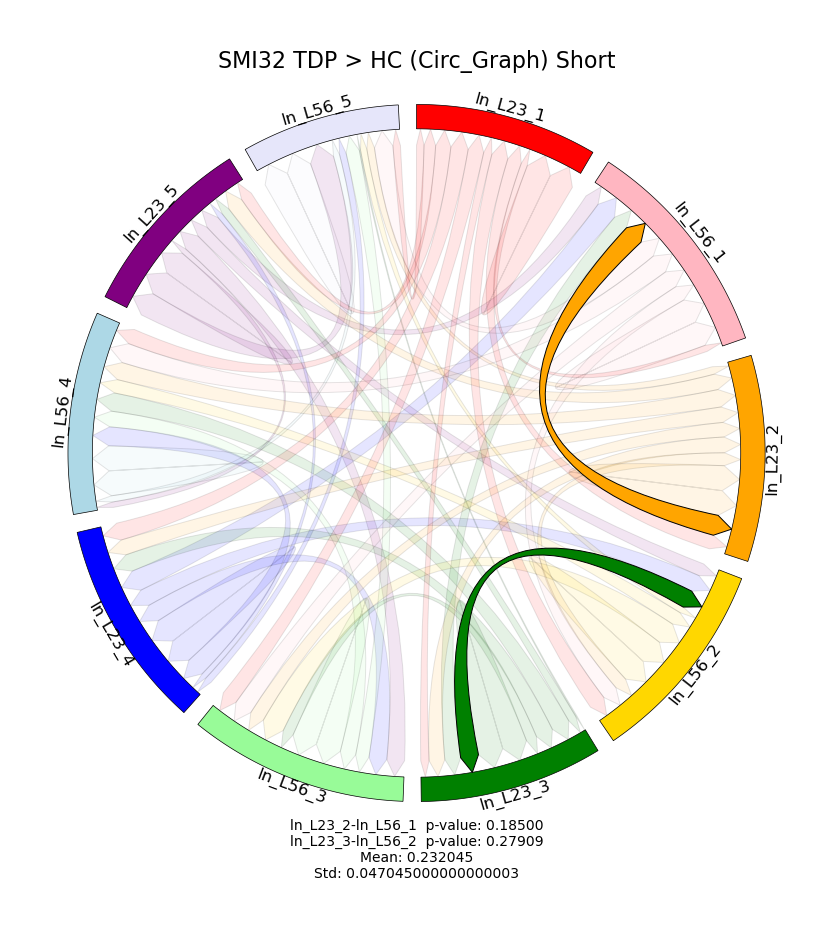

In [41]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## Tau > TDP

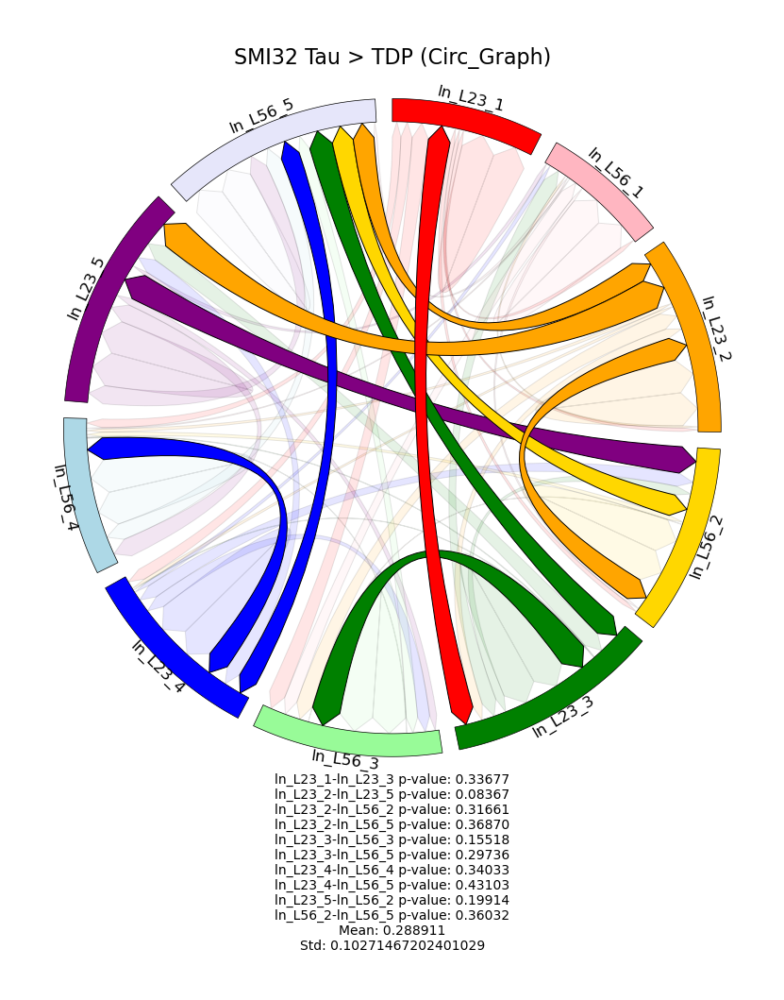

In [42]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

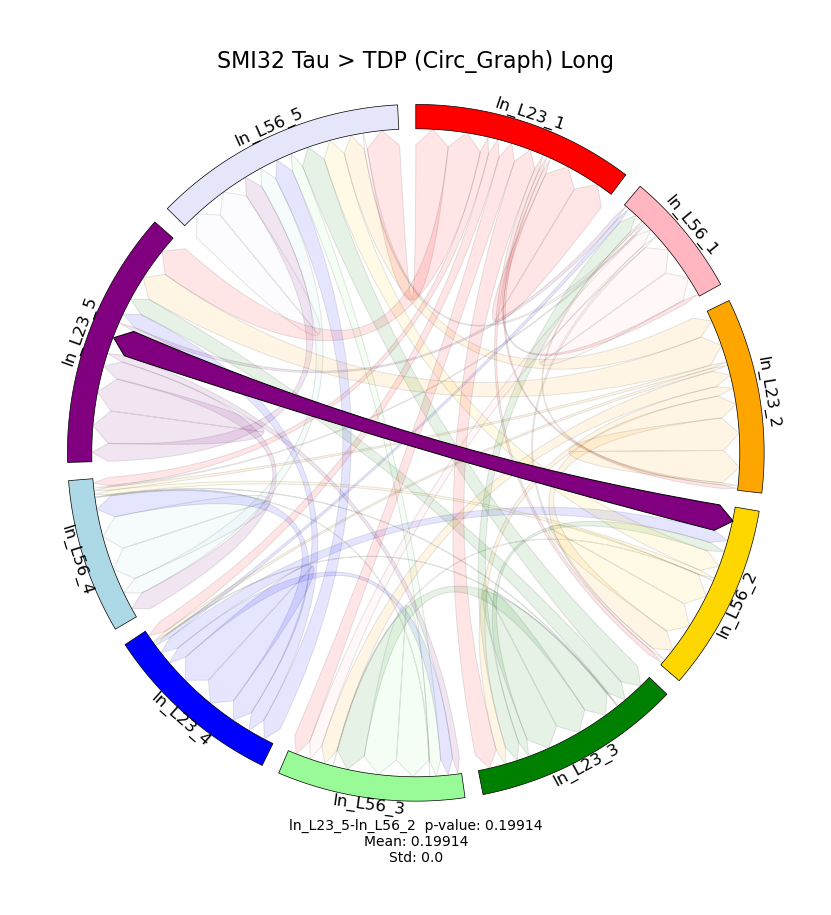

In [43]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

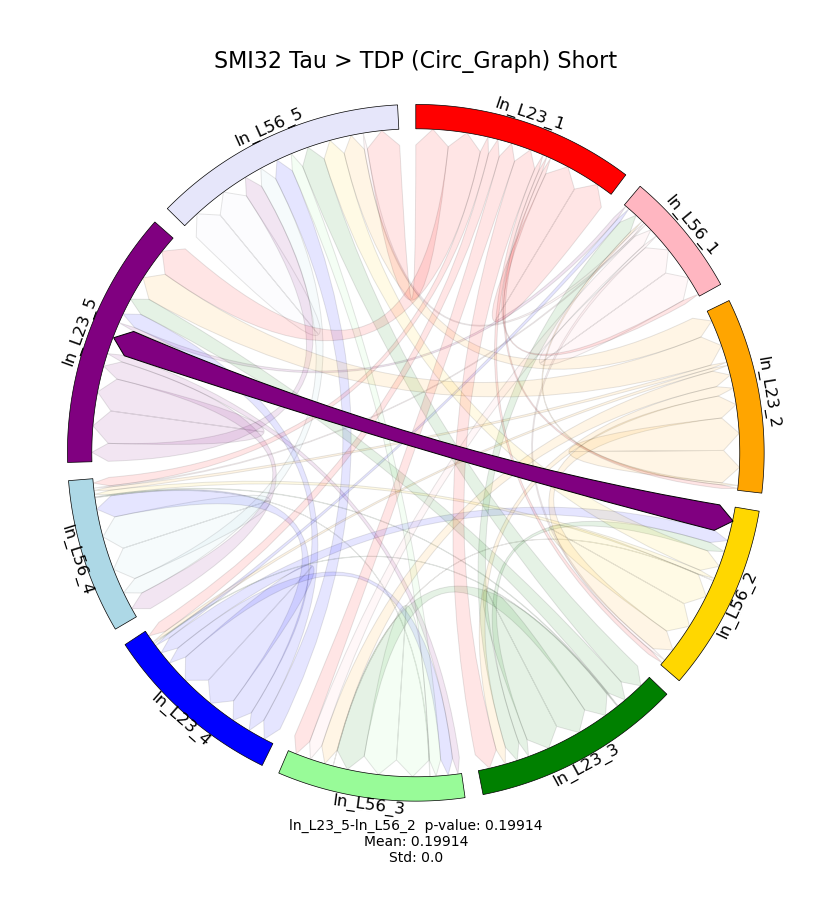

In [44]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## TDP > Tau

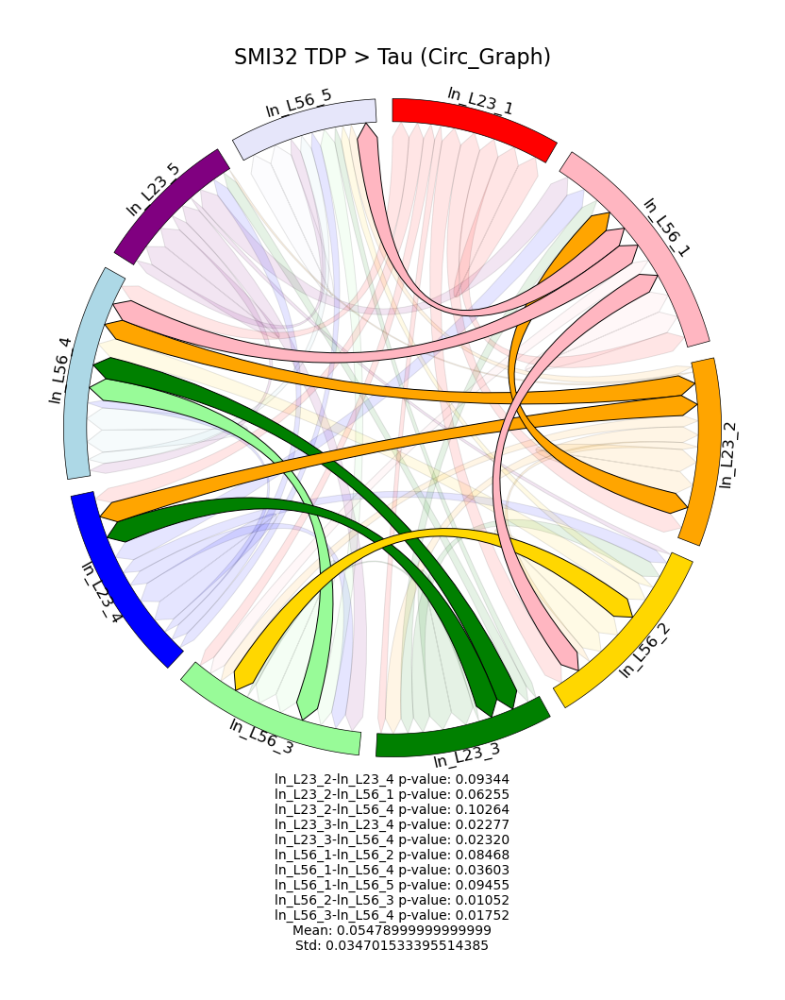

In [45]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

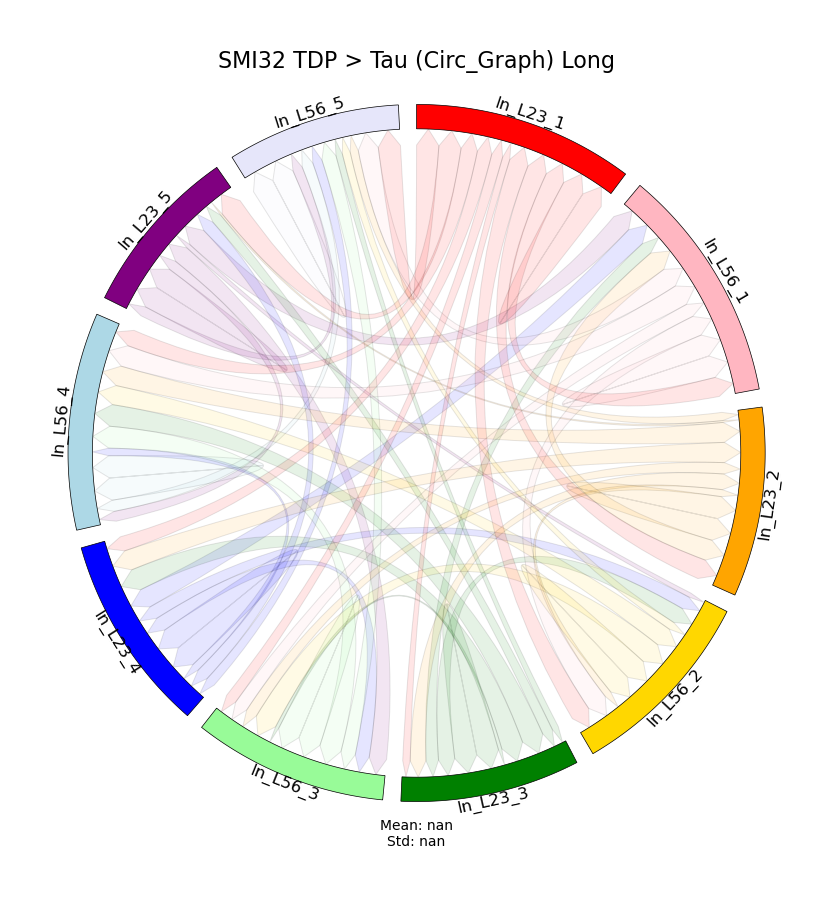

In [46]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

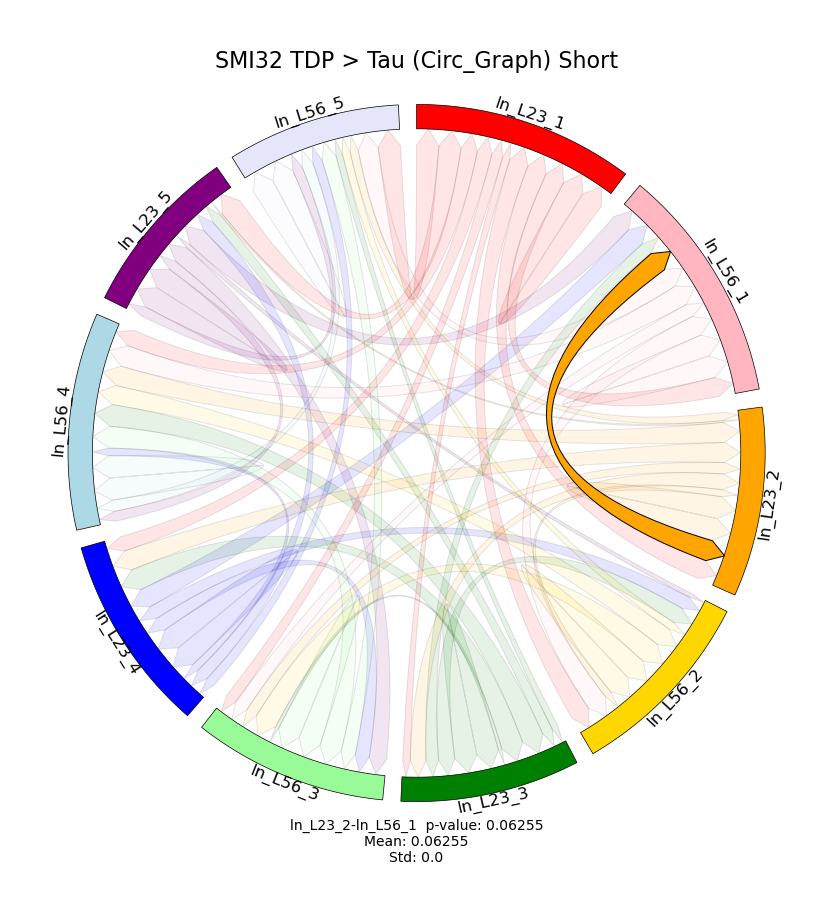

In [47]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

# Draw Graph Networks (NeuN) W Score

### Define Variables

In [48]:
# Variable setting
neuron_type = "SMI32(W Score)"

cov_dict = cov_SMI32_dict_w
data_label = SMI32_Labels

## HC

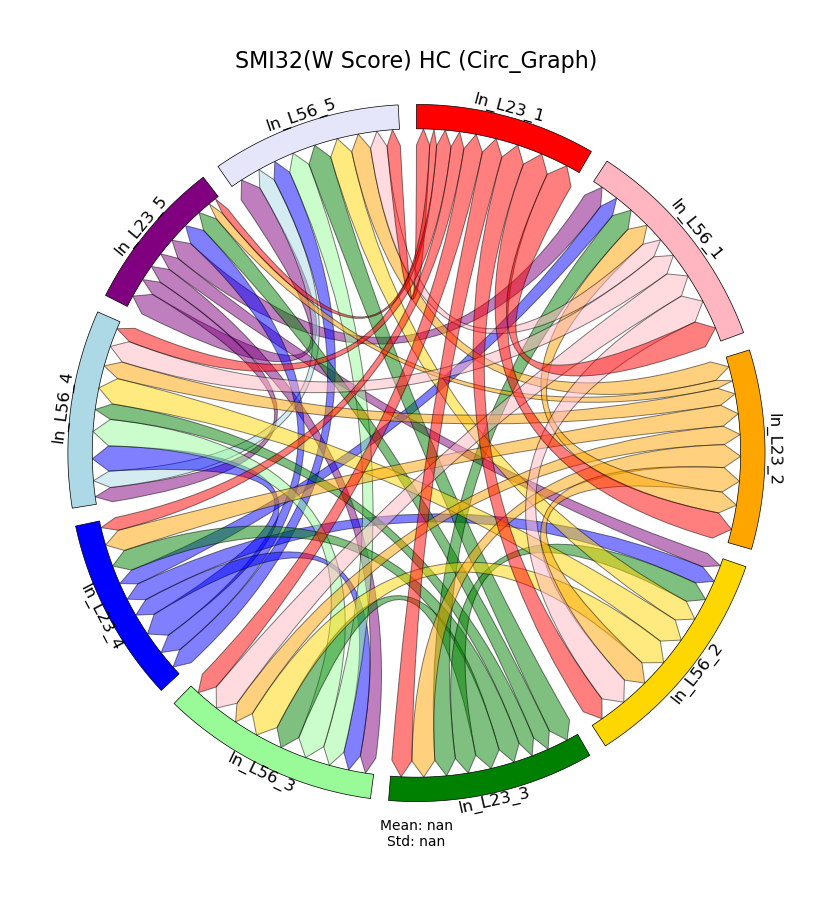

In [49]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

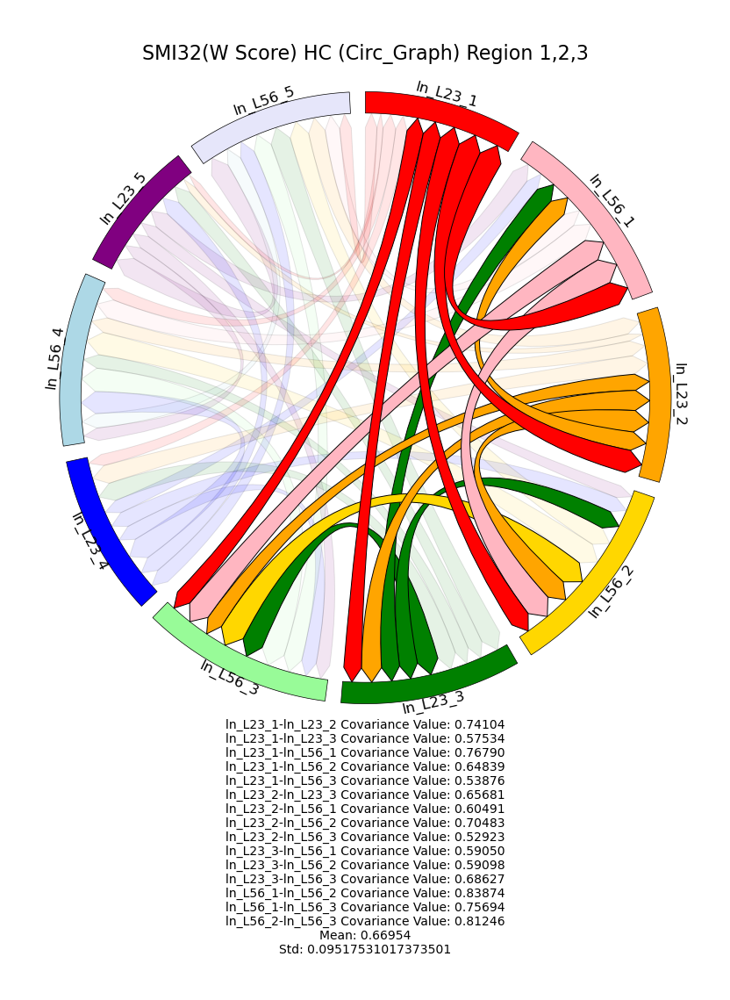

In [50]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track, 
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

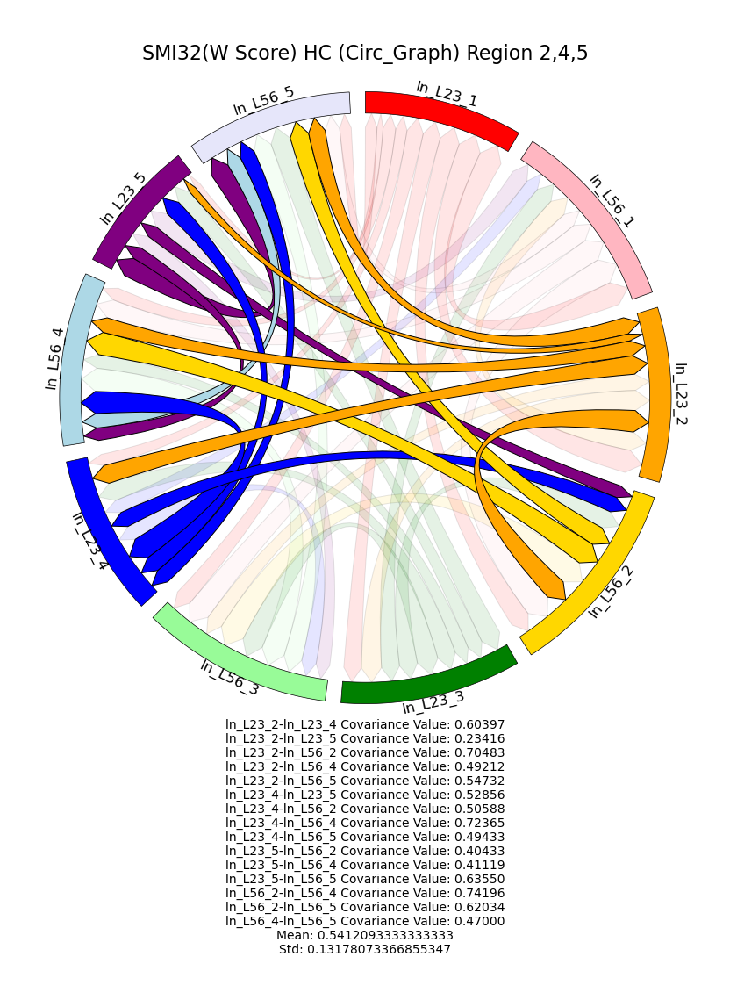

In [51]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track, 
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

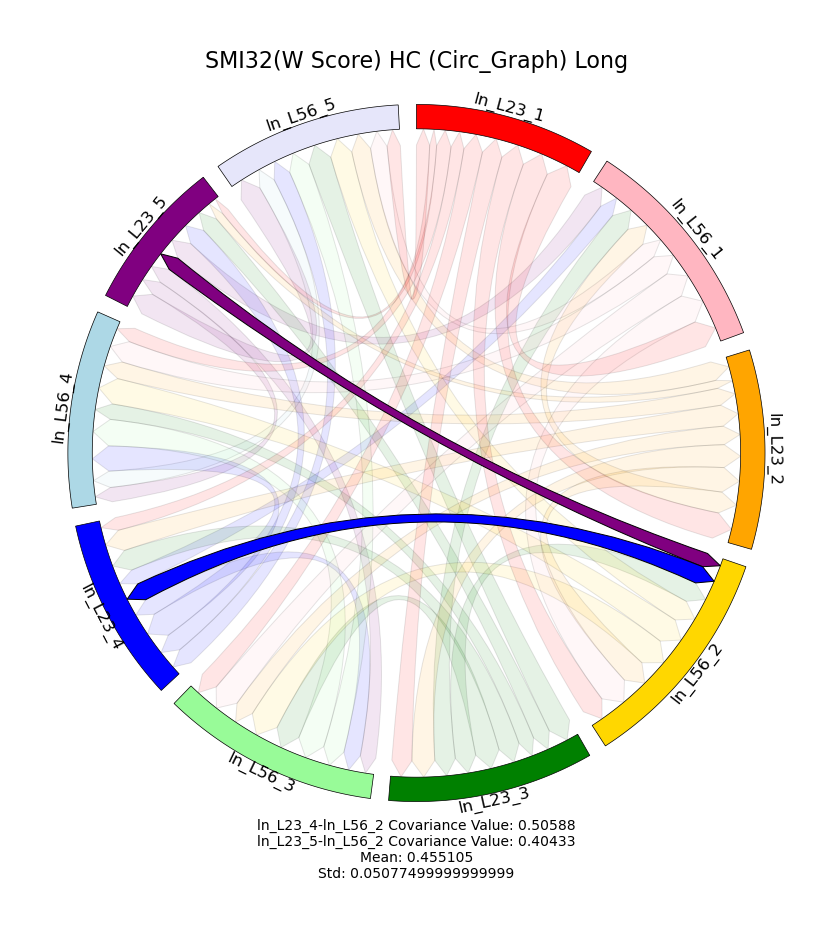

In [52]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long = True)

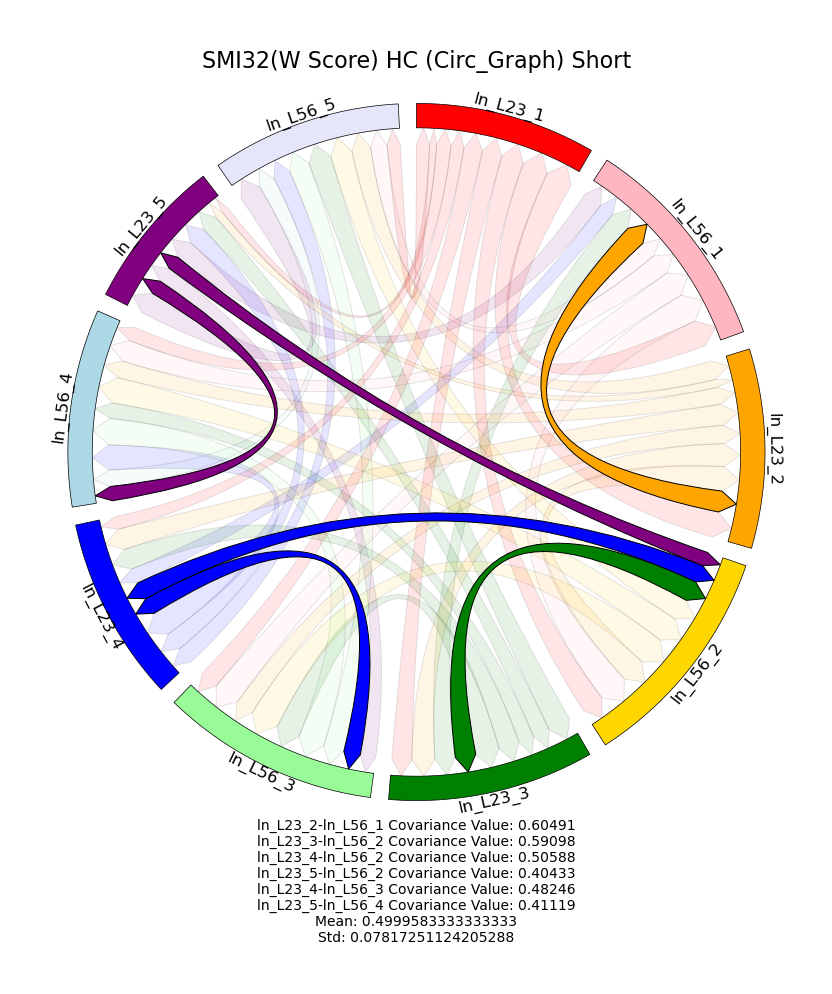

In [53]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short = True)

## Tau

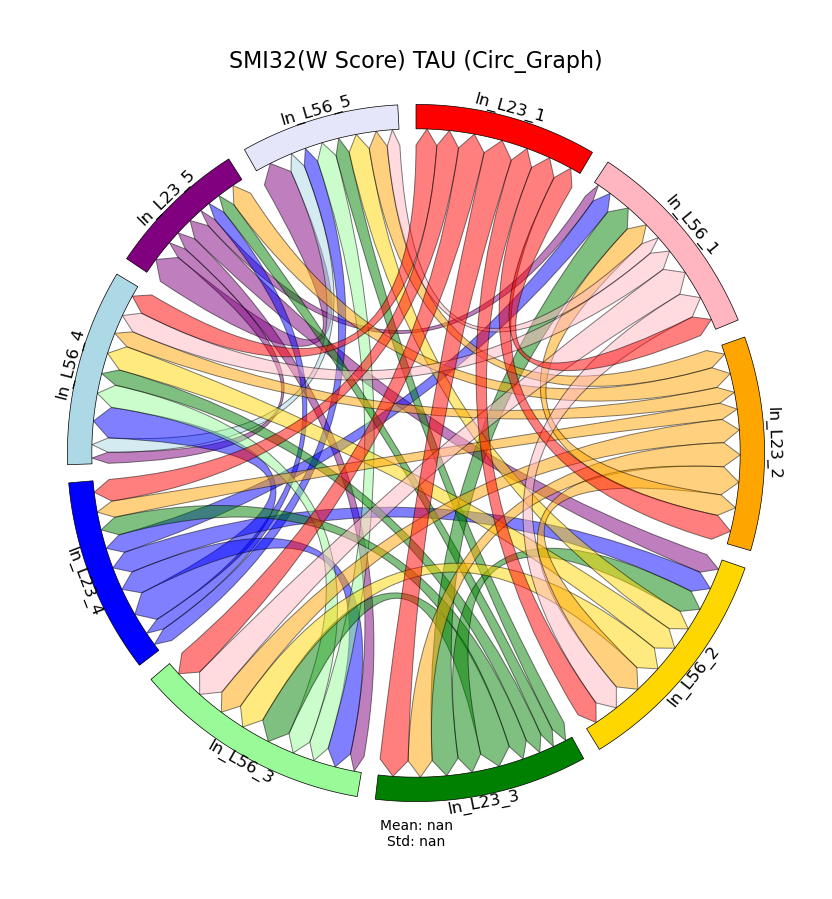

In [54]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

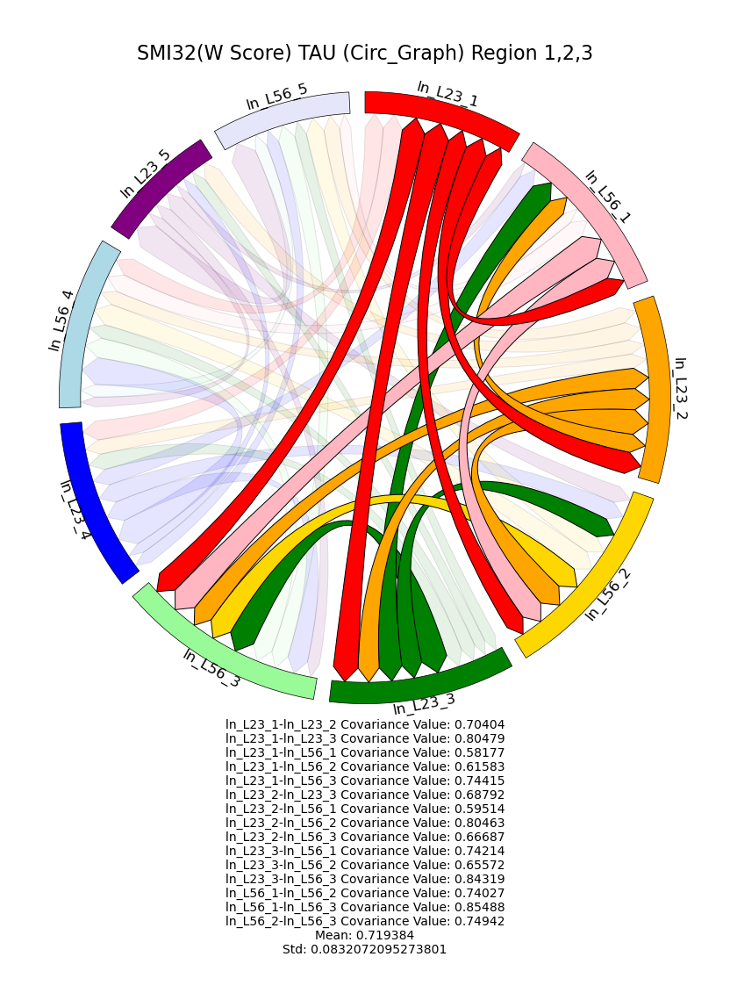

In [55]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track, 
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

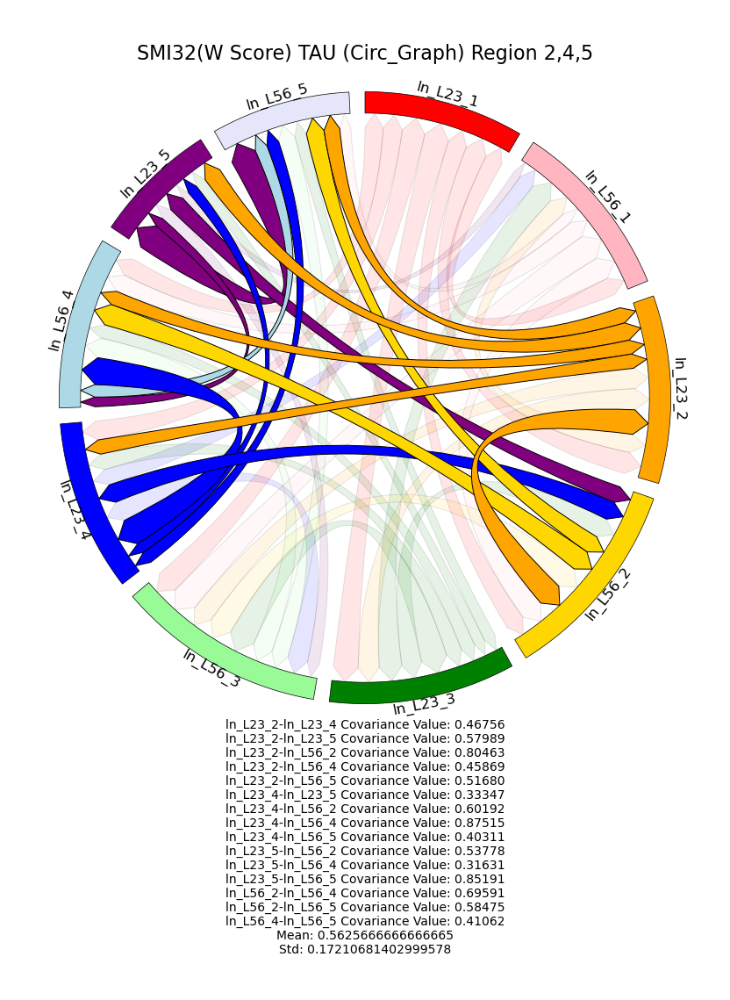

In [56]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track, 
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

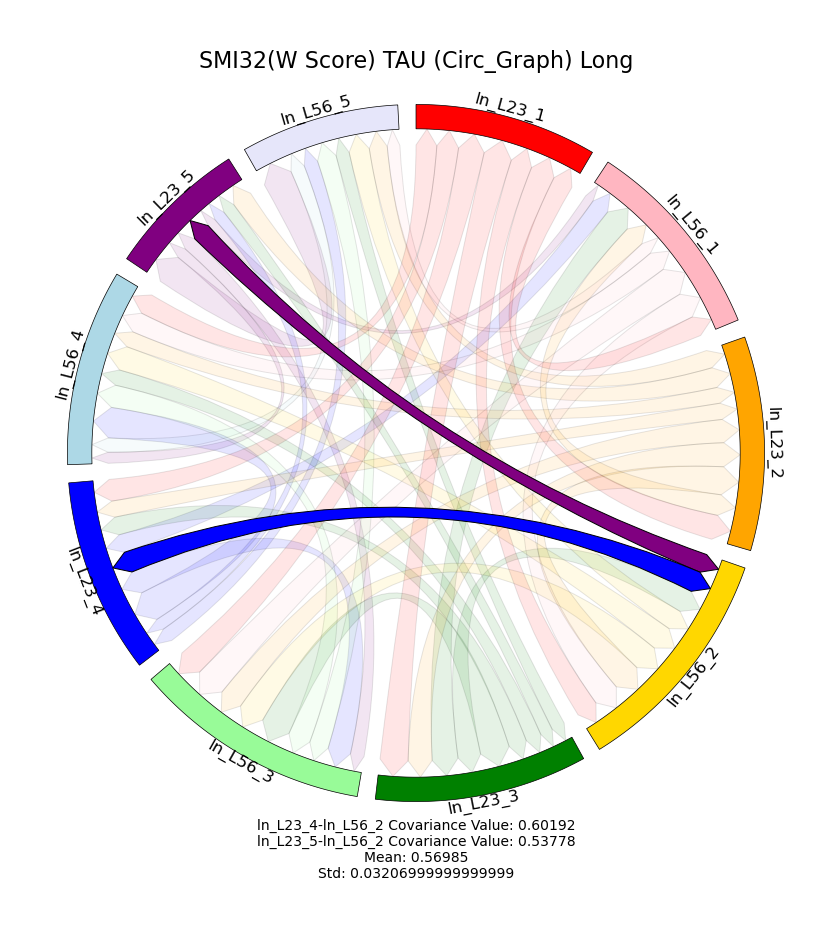

In [57]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long=True)

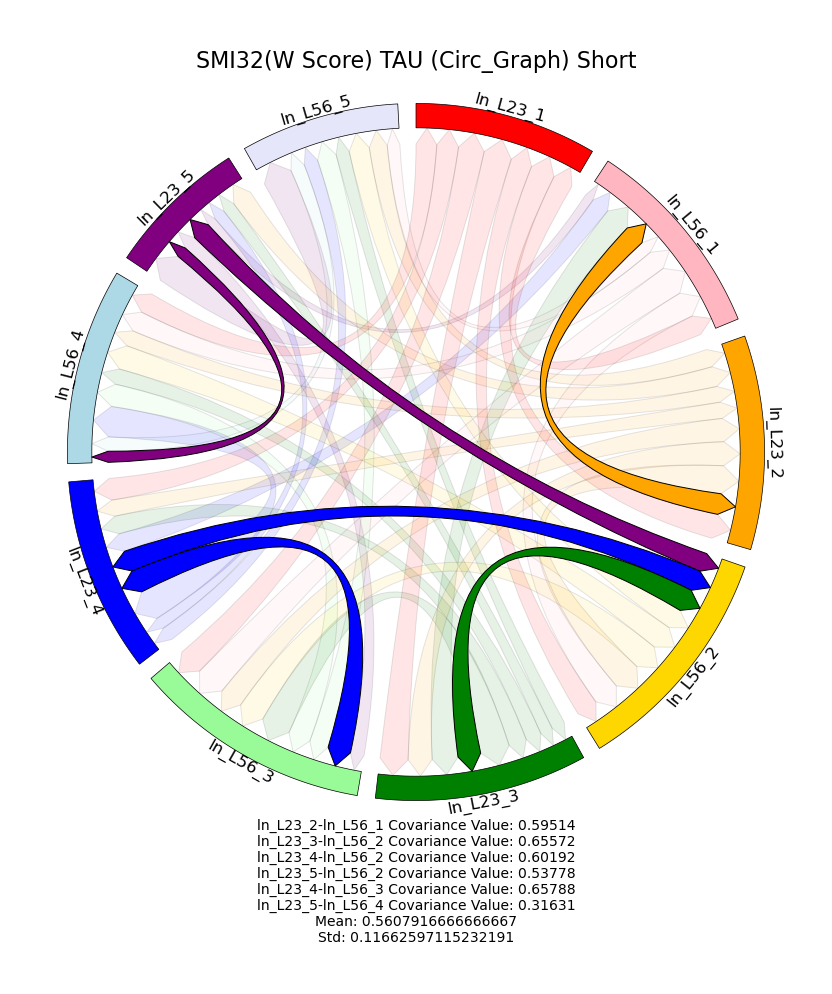

In [58]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short=True)

## TDP

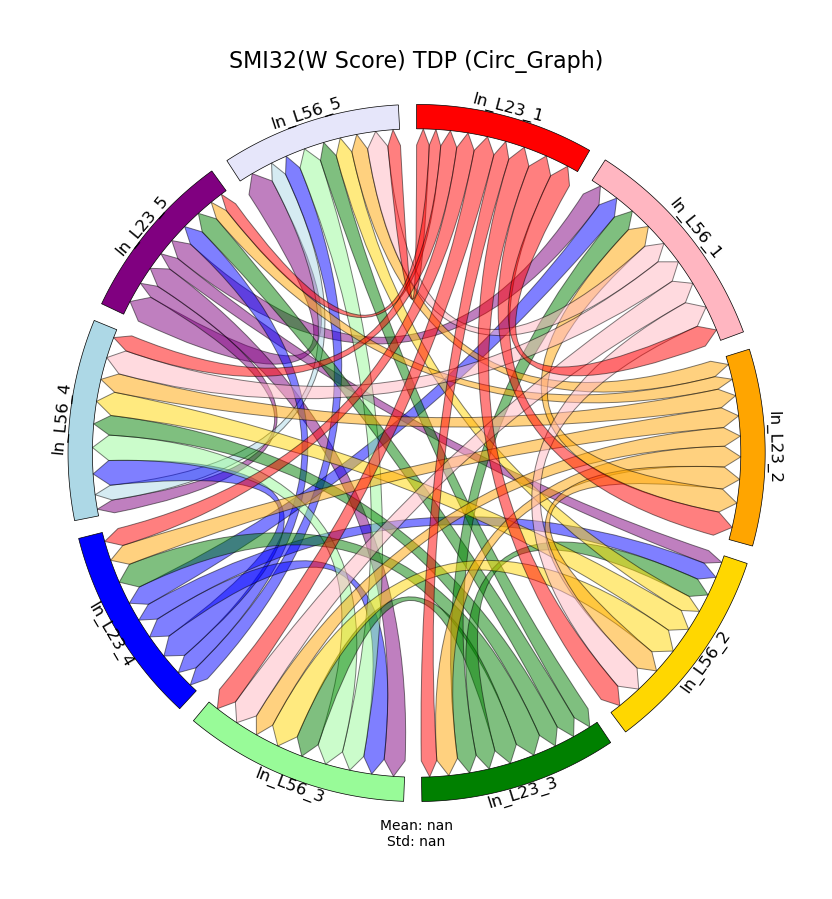

In [59]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

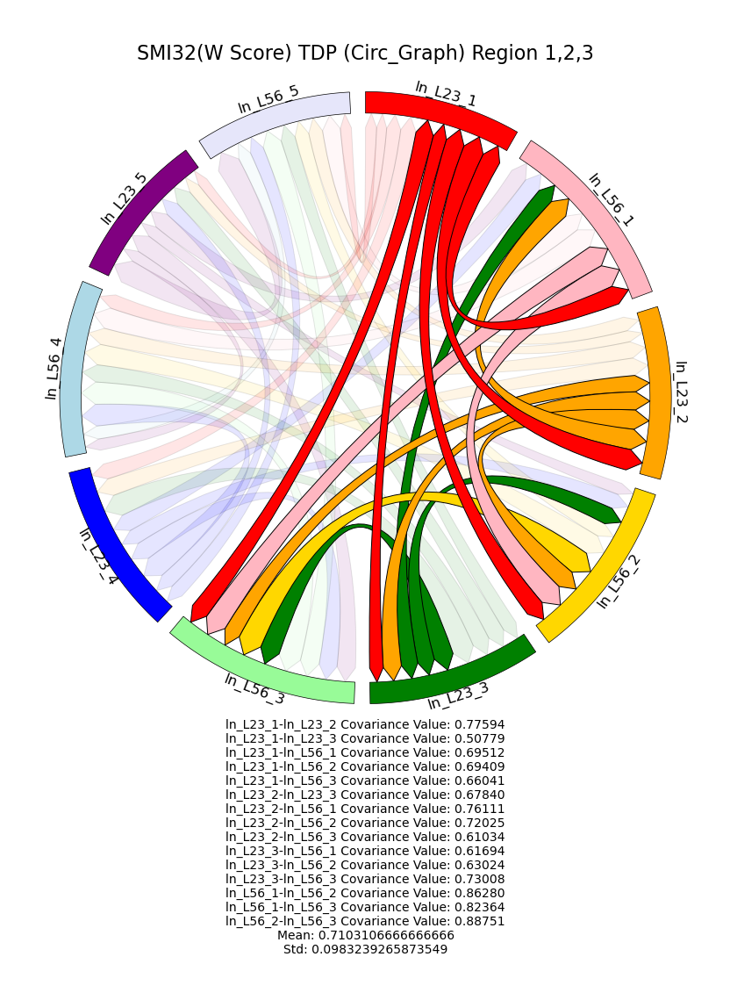

In [60]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track,
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

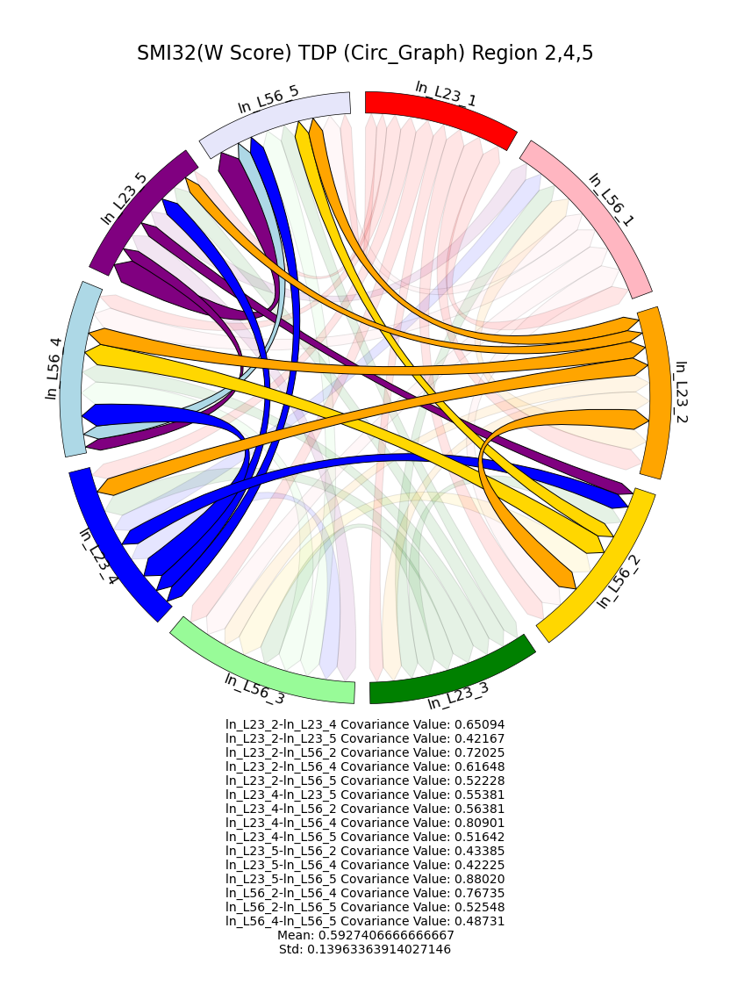

In [61]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track,
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

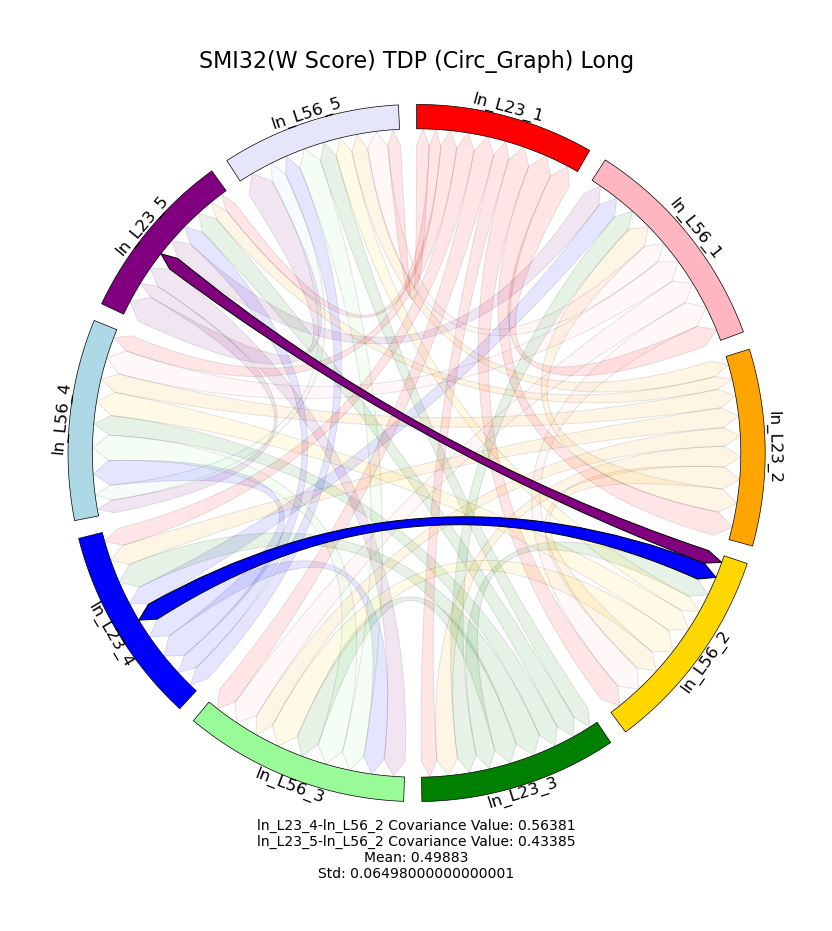

In [62]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long=True)

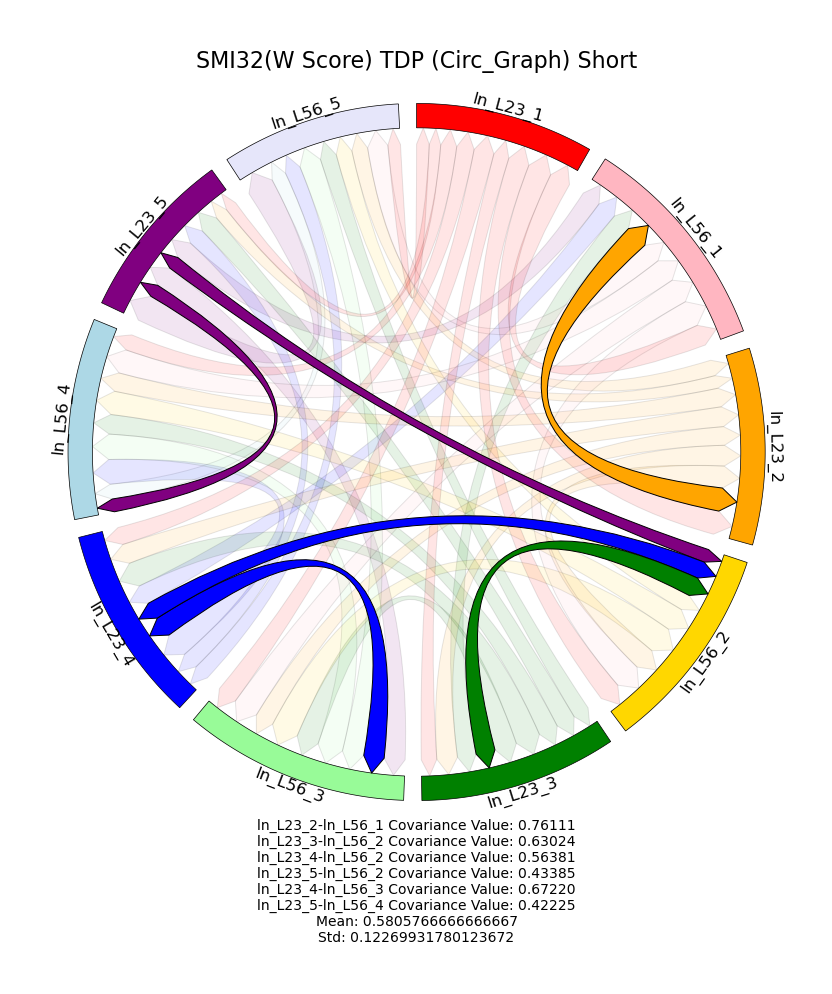

In [63]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short=True)

## HC > Tau

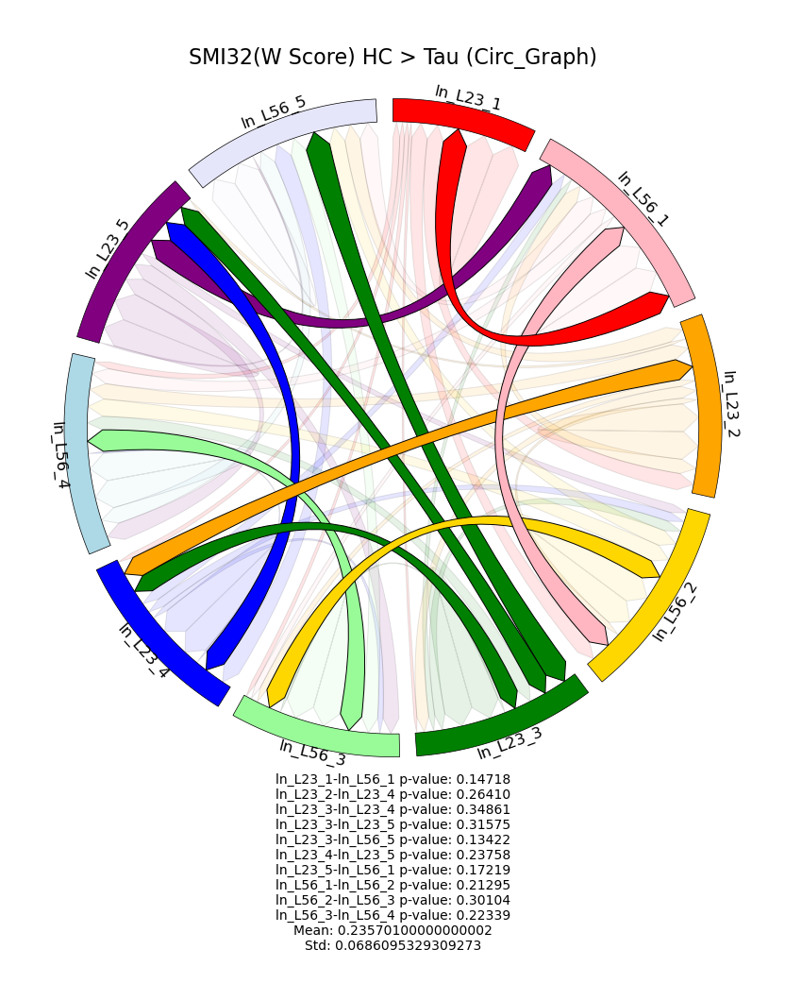

In [64]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

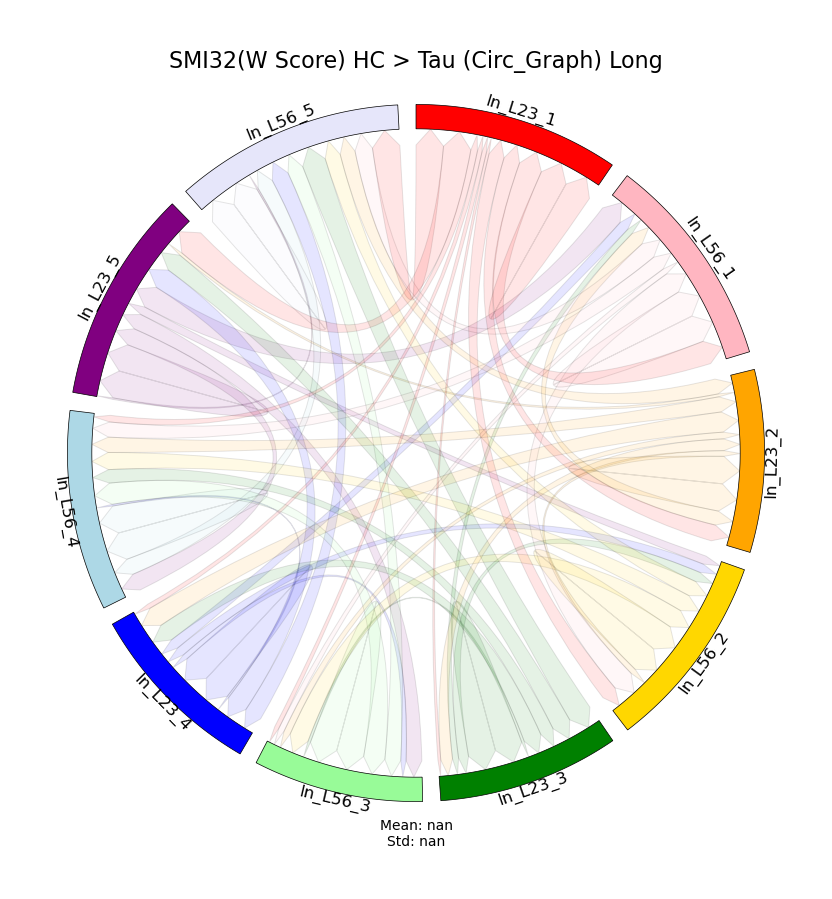

In [65]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

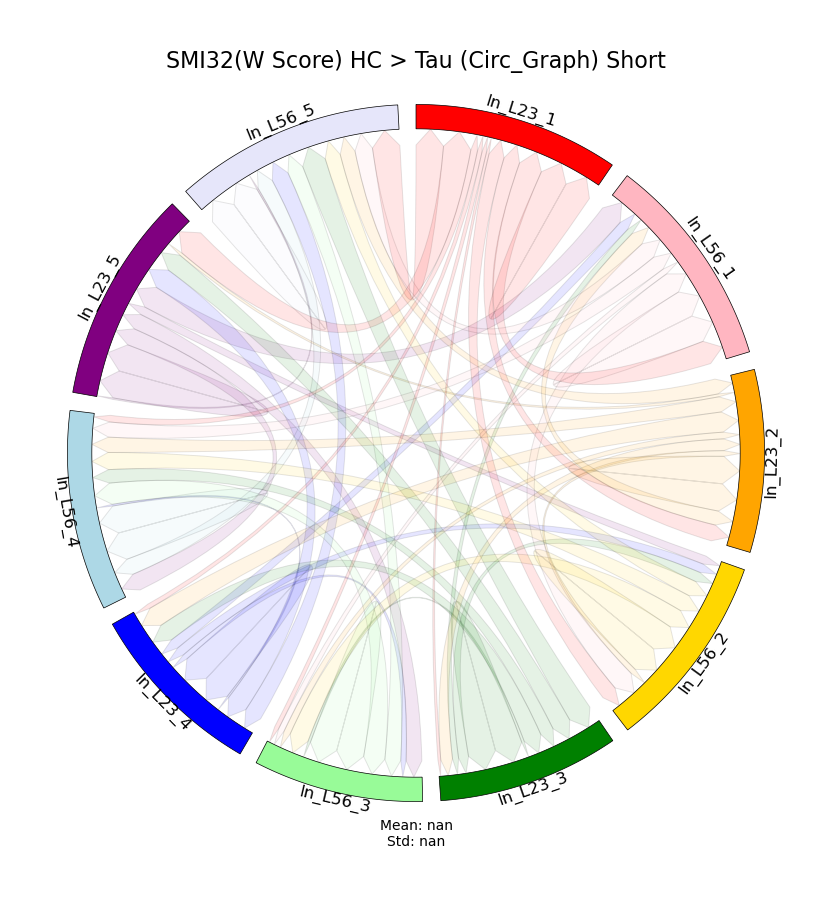

In [66]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## Tau > HC

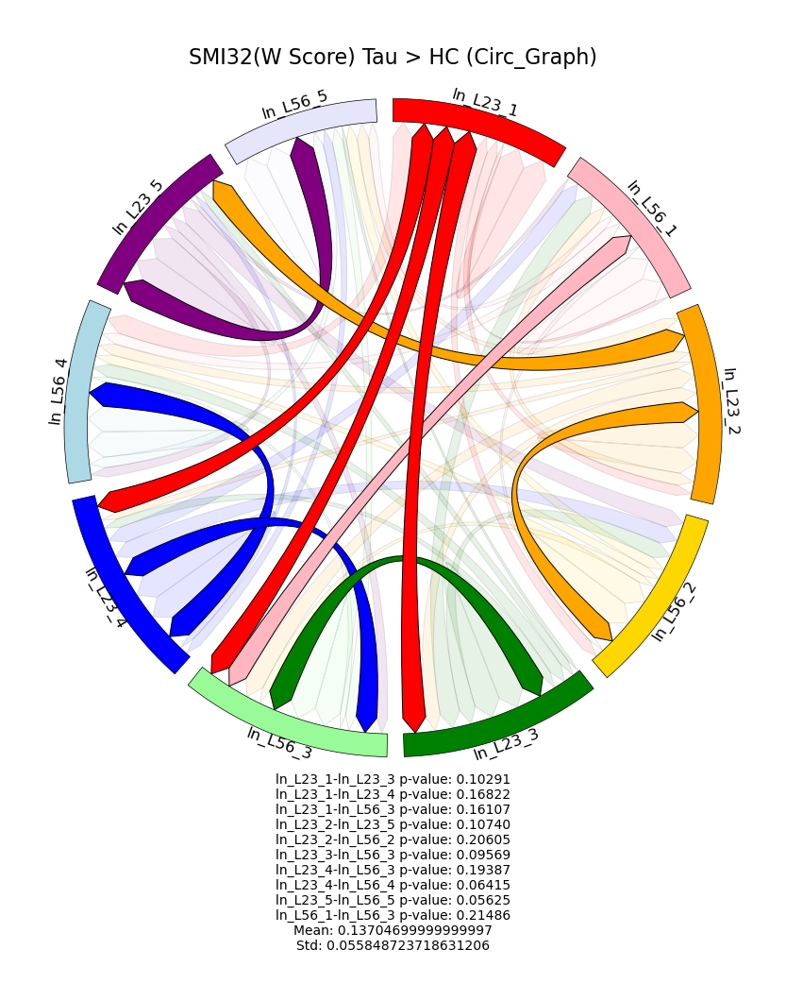

In [67]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

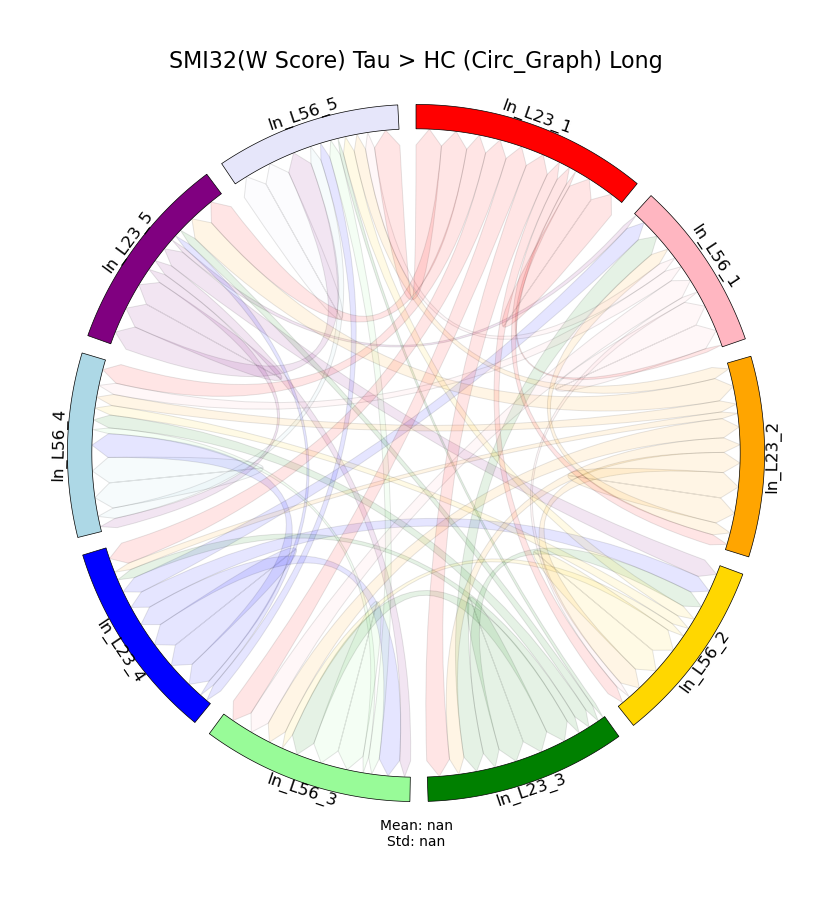

In [68]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

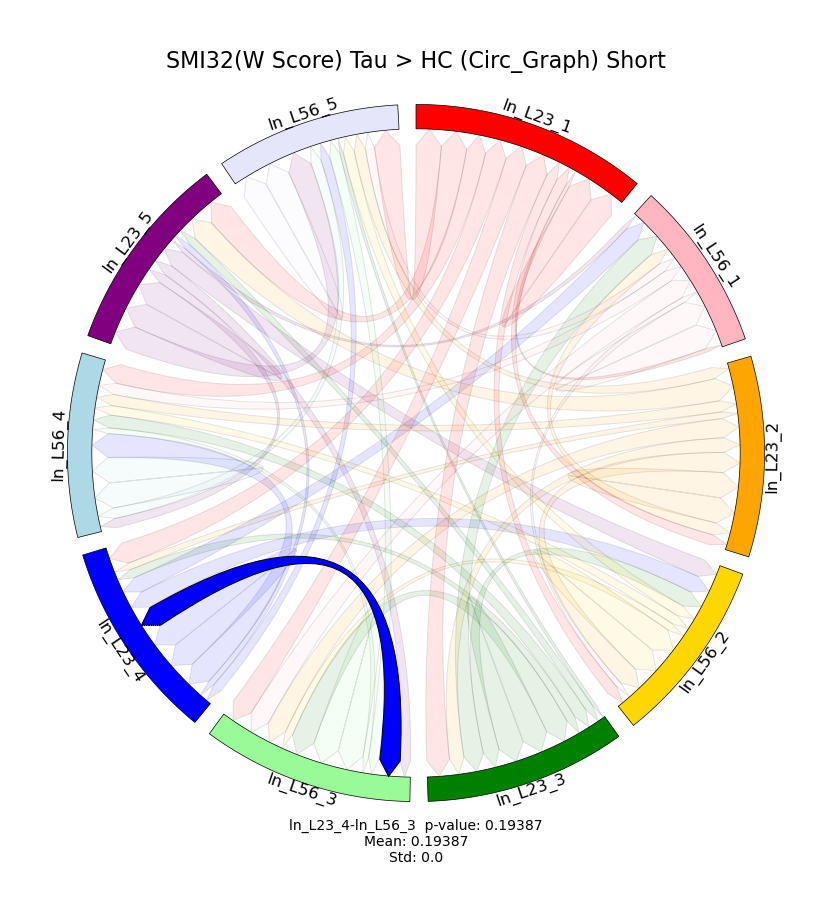

In [69]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## HC > TDP

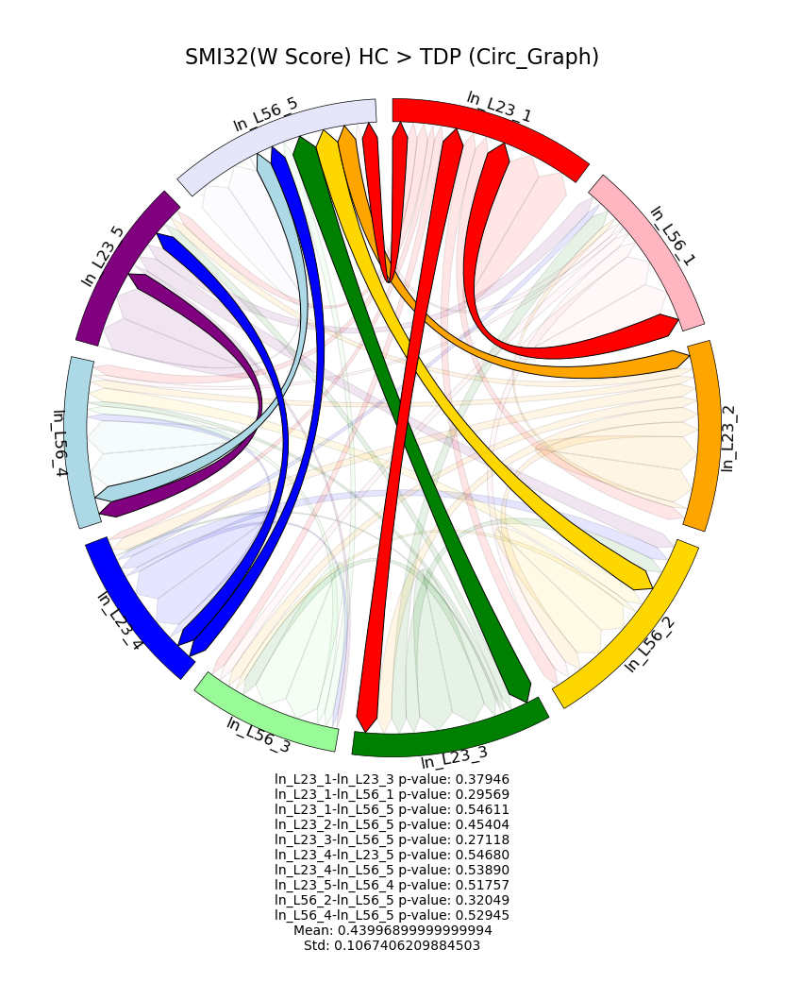

In [70]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

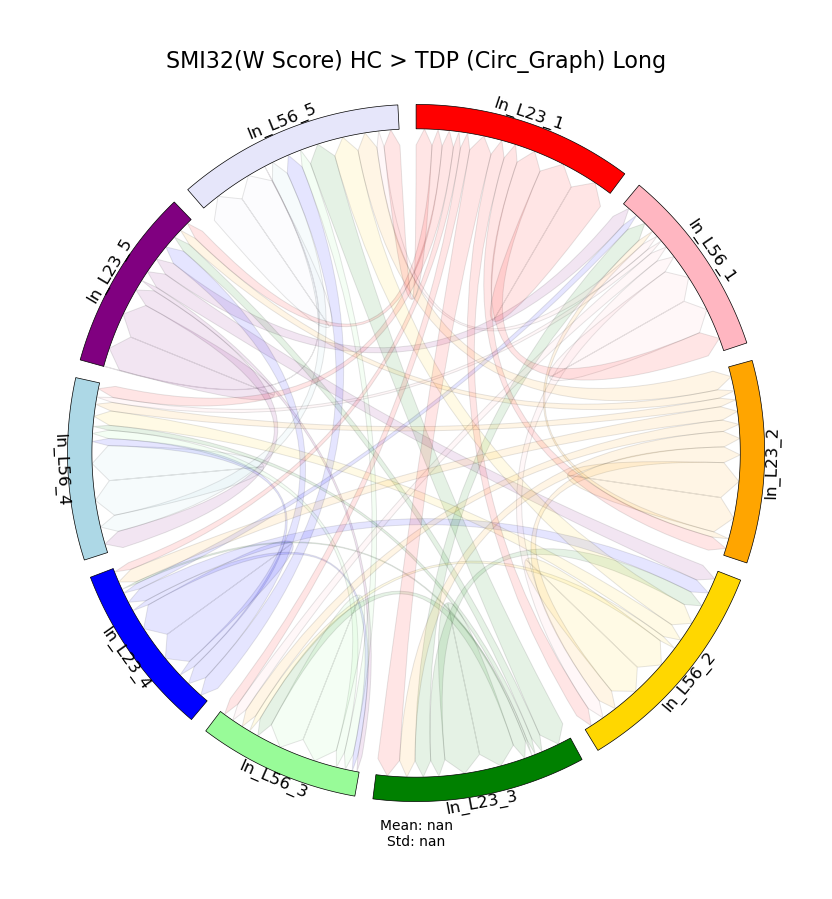

In [71]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

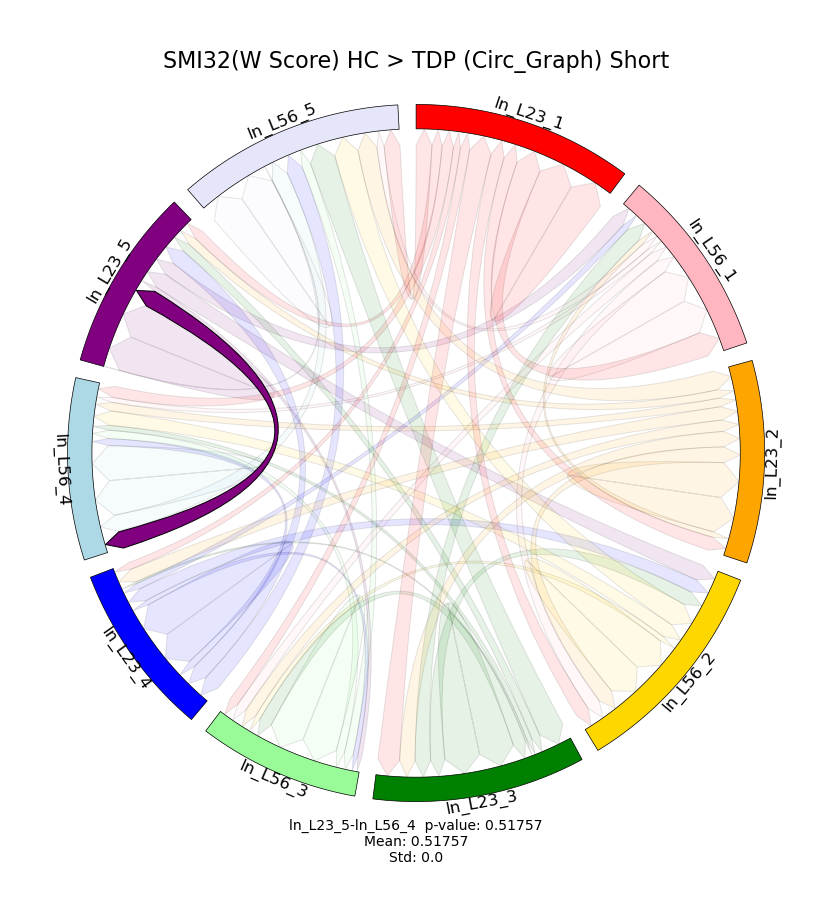

In [72]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## TDP > HC

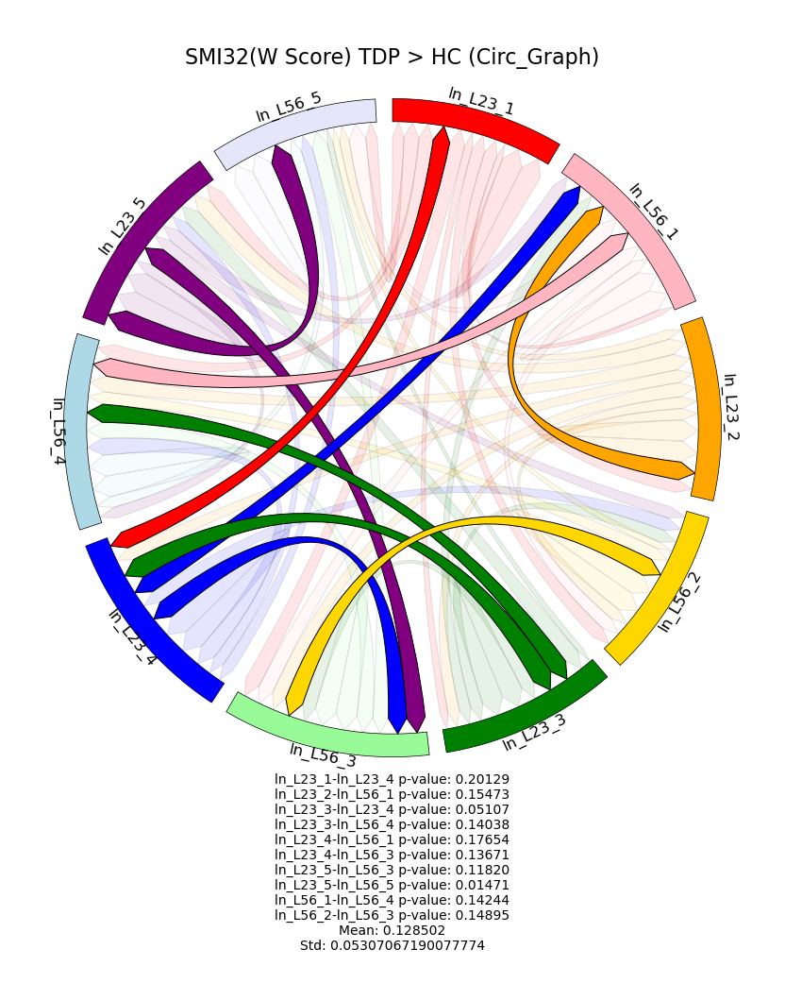

In [73]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

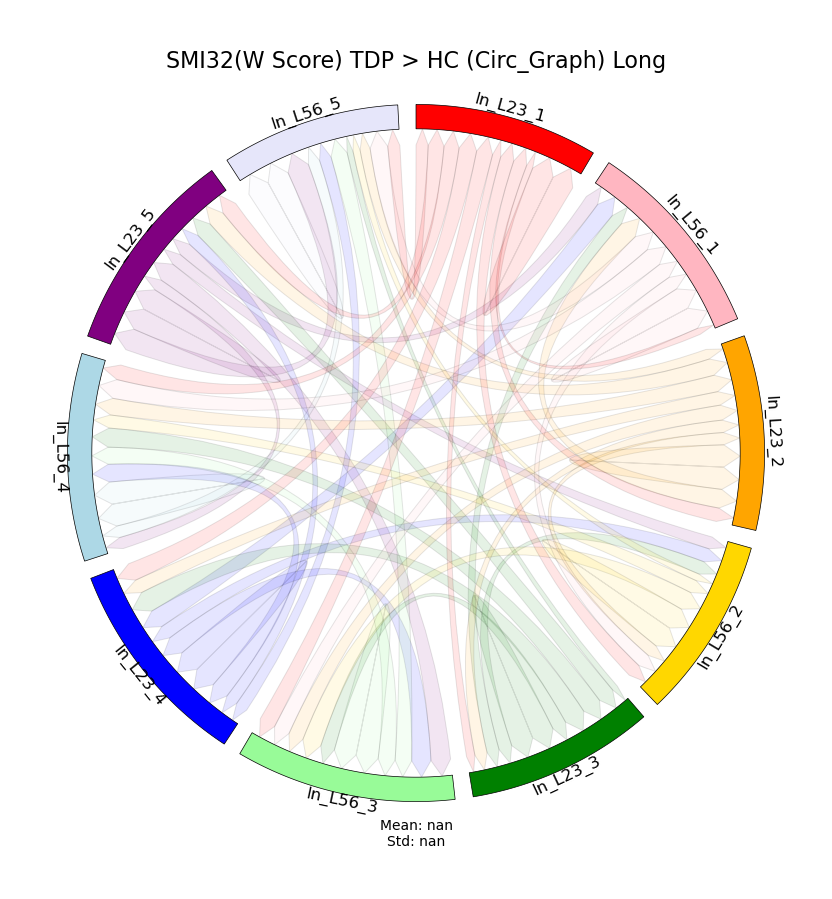

In [74]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

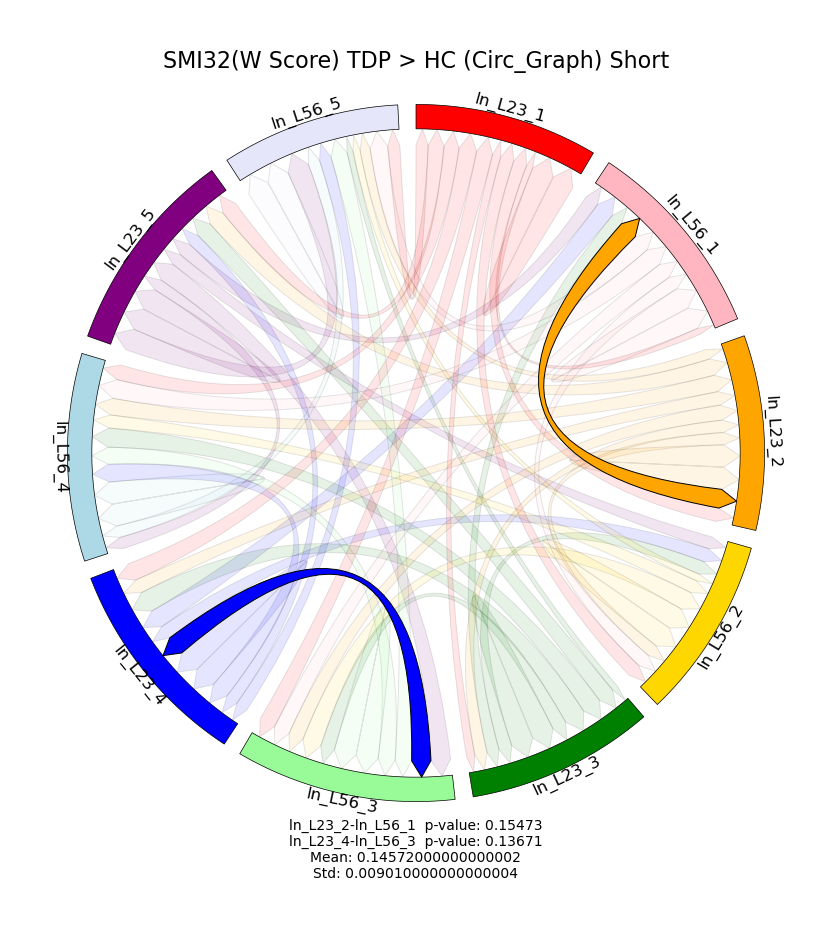

In [75]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## Tau > TDP

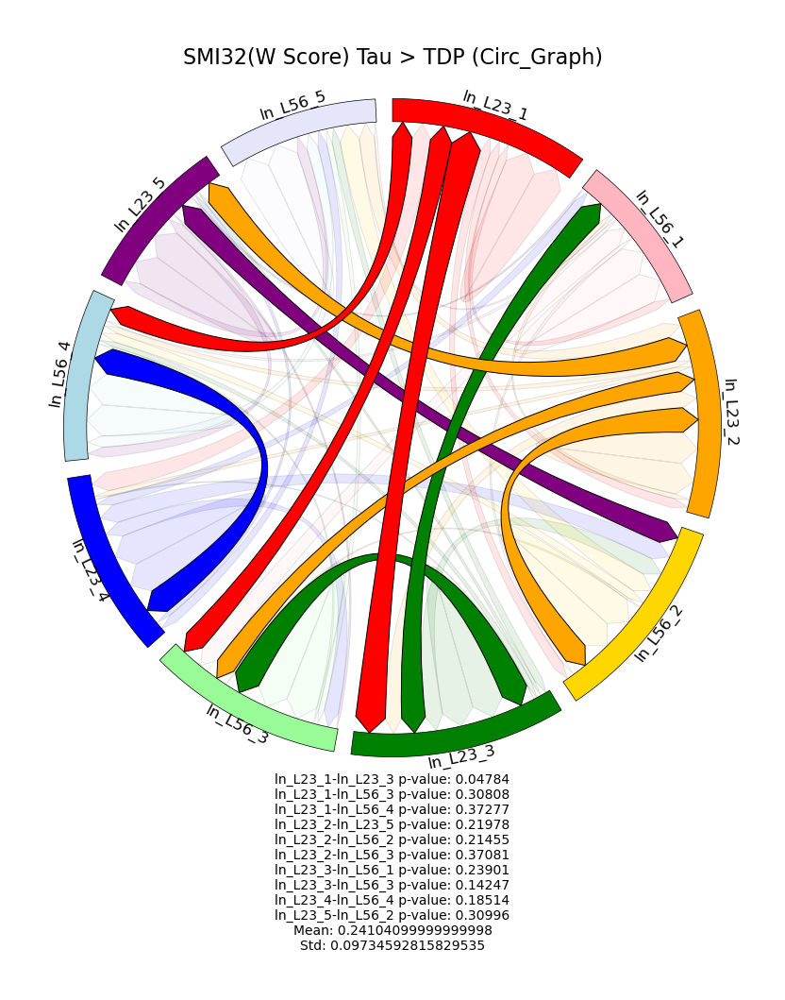

In [76]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

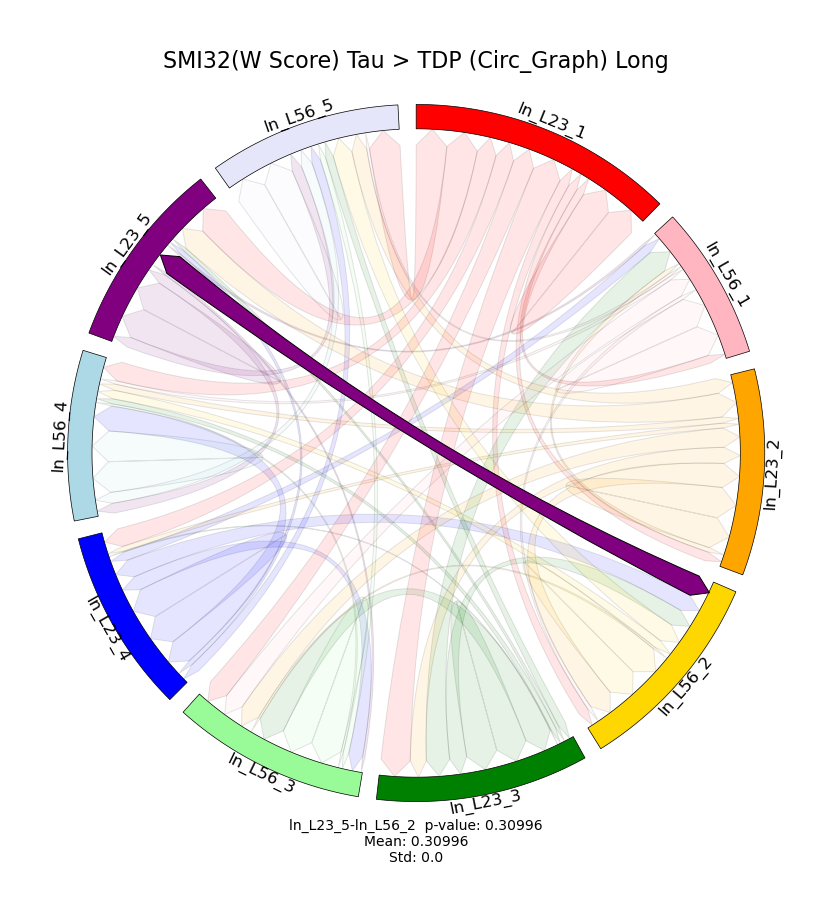

In [77]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

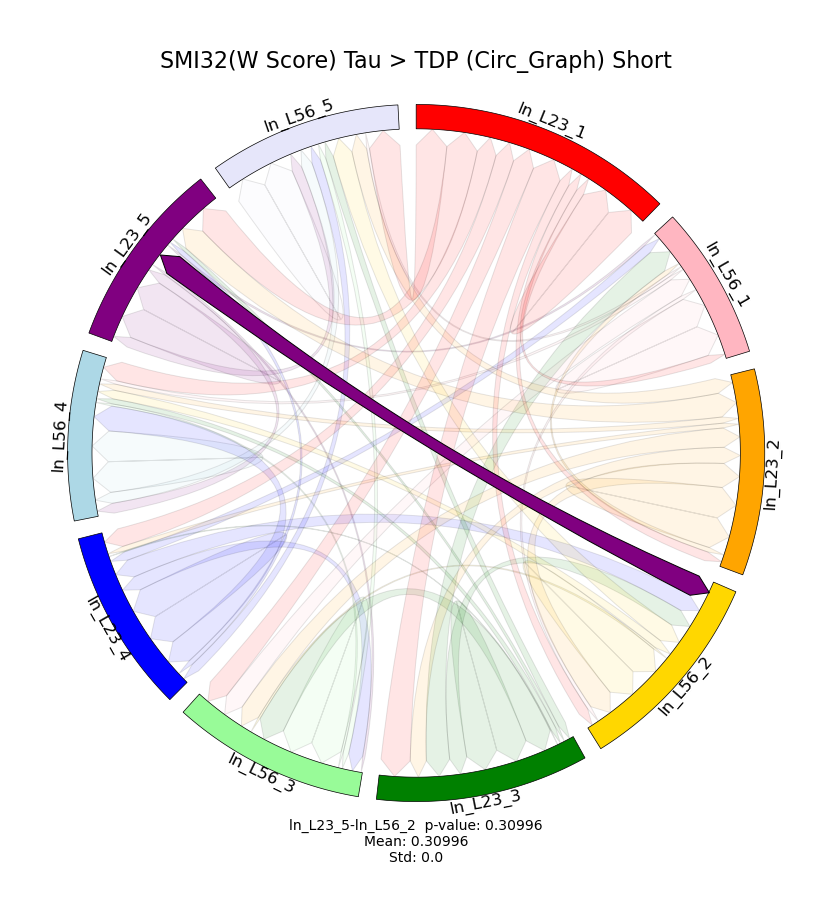

In [78]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## TDP > Tau

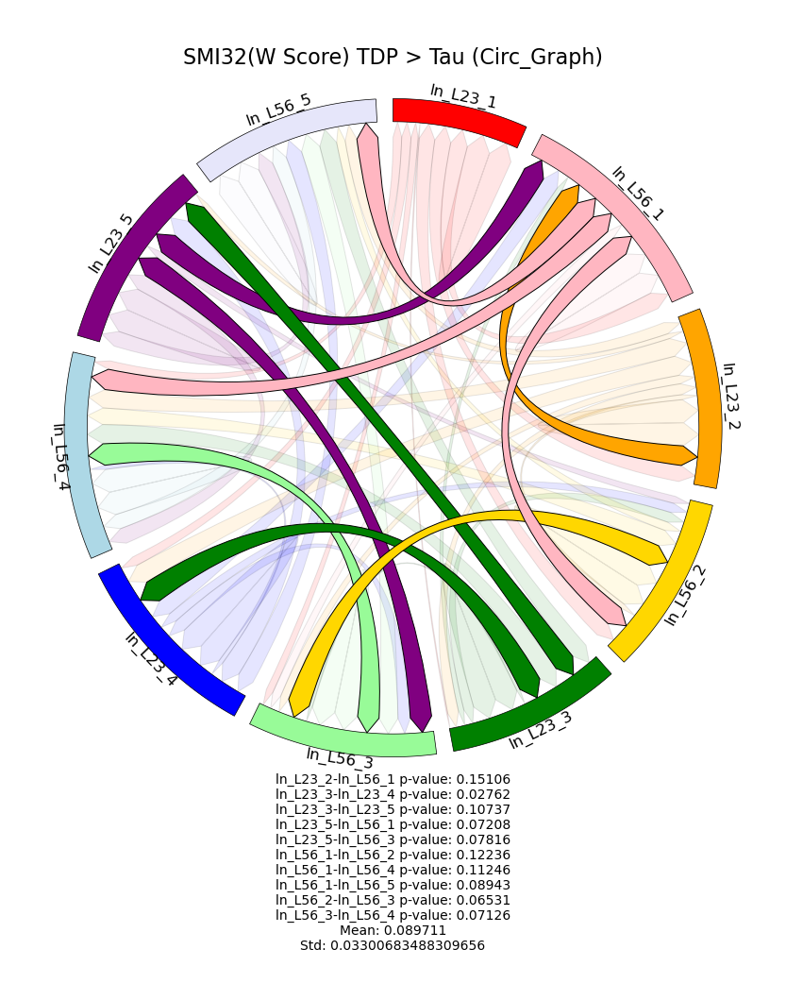

In [79]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

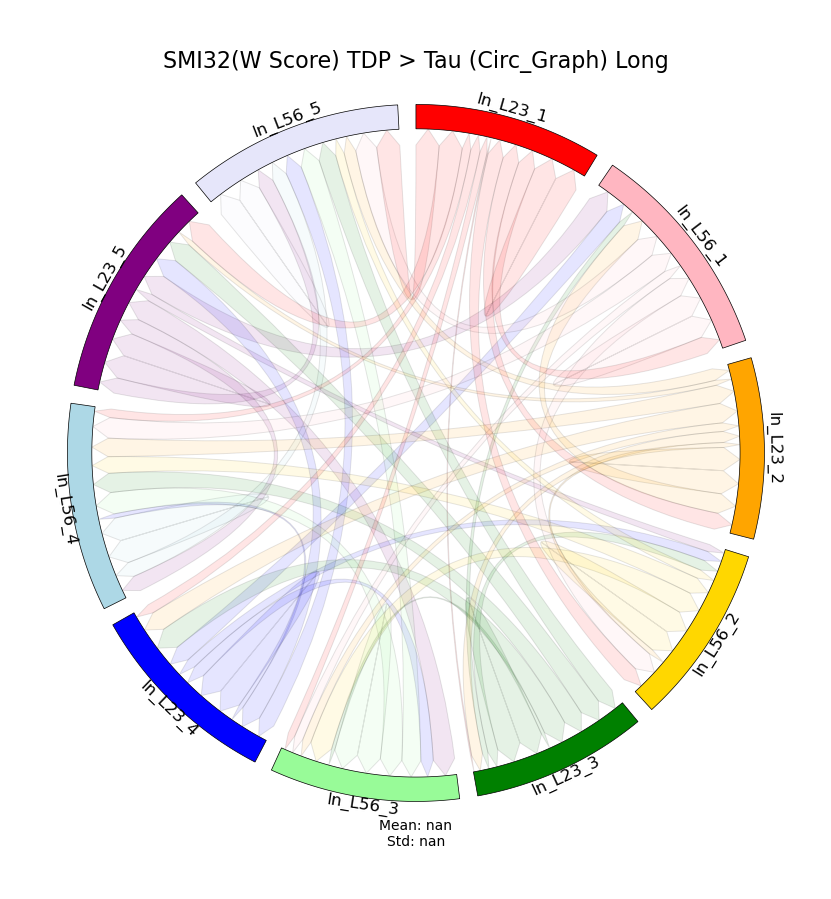

In [80]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

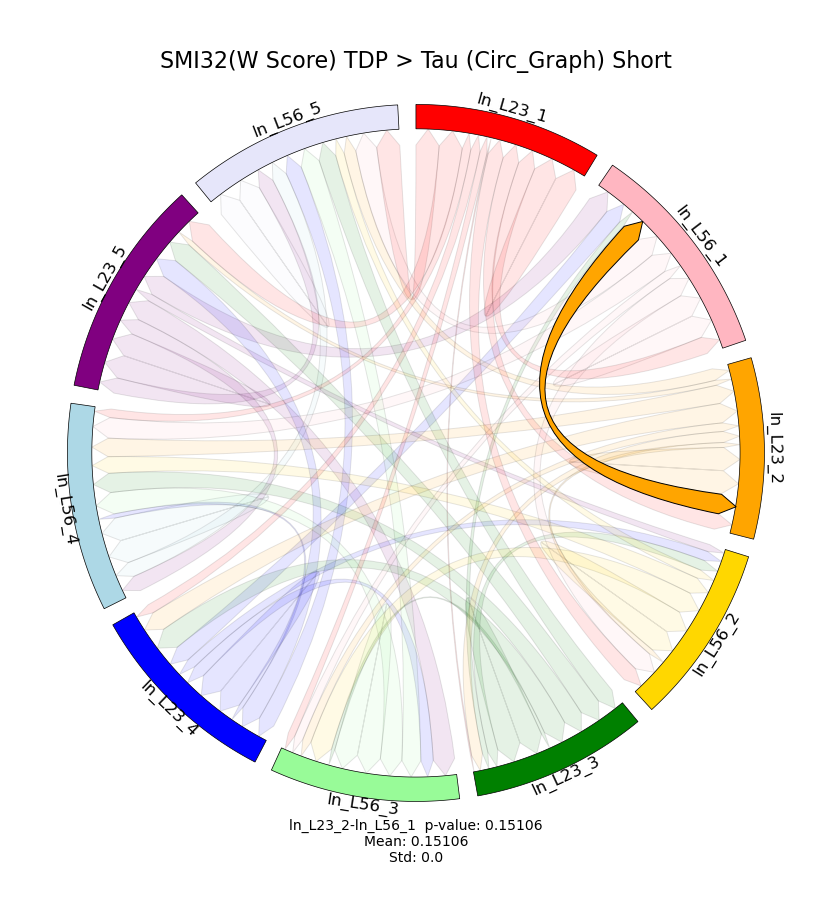

In [81]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

# Things to do (12/7)

# Some of the connections to focus on [Done]

Longer range connections
* Region 2 layer56 <-> Region 4 or 5 layer 23

Relatively Long Connections
* Region 1 layer 56 <-> Region 2 layer 23
* Region 2 layer 56 <-> Region 3, 4, 5 layer 23
* Region 3 layer 56 <-> Region 4 layer 23
* Region 4 layer 56 <-> Region 5 layer 23

# Find metrics to model degeneration

* Direct paired differences as connections

Test for only HC, Tau, TDP

# Try generating with just [DONE]
* region 3, 2, 1 (6 nodes)

# Generate [DONE]
* Region 2, 4, 5 (6 nodes) --> Longer tracks (WM) therefore should show more up in Tau


# FIX color map [DONE]
 
# Network Structure --> Double 2 circle [DONE]


# Literature search
* ~ Structural MRI --> Covariance Network Analysis: How they interpret their results / Volume, thickness, shape (measurements that can be derived at each regions / NOT direct connections such as DTI).
* Structural similarity networks. (not covariance, calculate feature vectors on MRI)